KÜTÜPHANELERİ İMPORTLADIK

In [25]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import img_as_float
from skimage.restoration import estimate_sigma
from skimage.measure import shannon_entropy

EN UYGUN OLARAK BELİRLEDİĞİMİZ PİPELİNE'I GÖRÜNTÜLERE UYGULAYIP OUTPUT KLASÖRÜNE KAYDETTİK.

FLARE22_Tr_0001_slice_62.png - Kalite Skoru: 21.3162


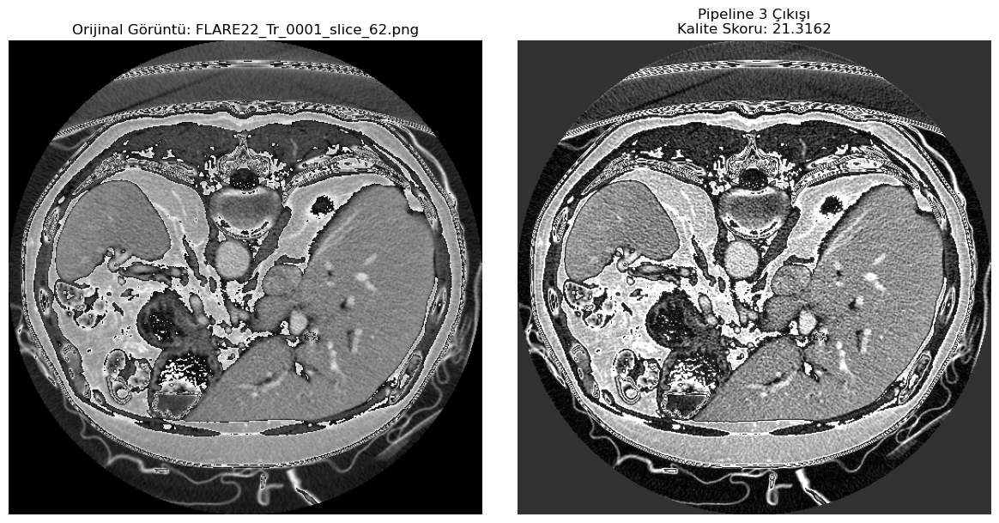

FLARE22_Tr_0001_slice_63.png - Kalite Skoru: 21.8756


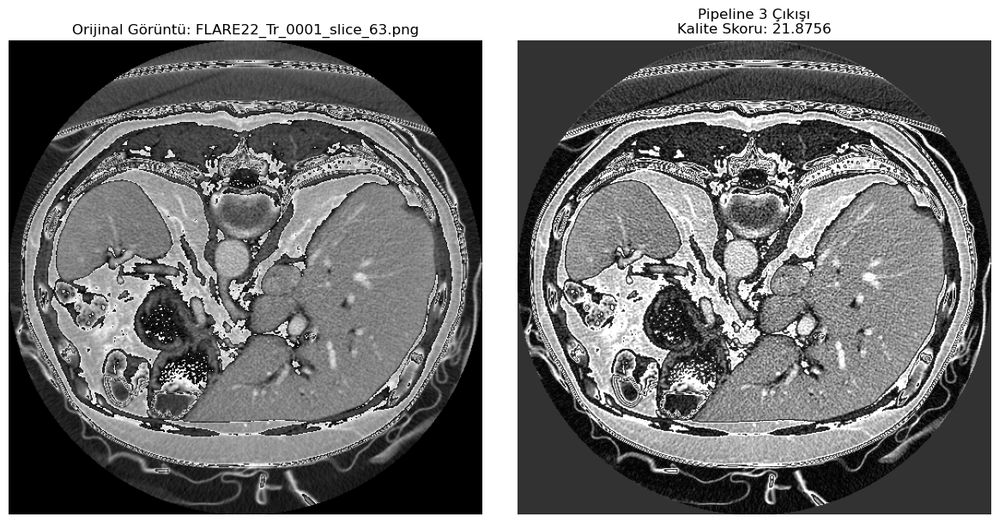

FLARE22_Tr_0001_slice_64.png - Kalite Skoru: 21.3597


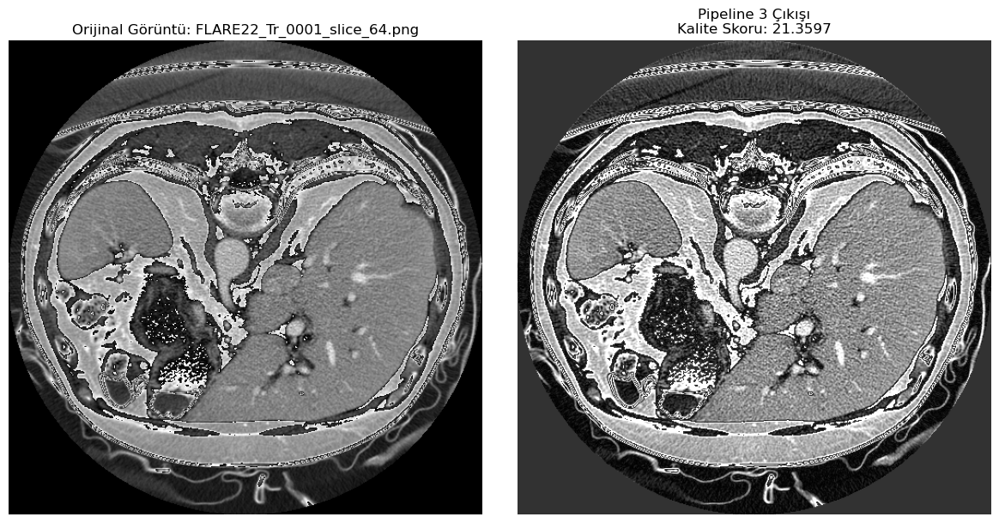

İlk 3 görüntü işlendi, daha fazla işlem yapılmıyor.


In [2]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import img_as_float
from skimage.restoration import estimate_sigma
from skimage.measure import shannon_entropy  
from skimage.filters import unsharp_mask

# Pipeline 3 fonksiyonu (Normalization -> Unsharp Masking -> Histogram Stretching -> Brightness and Contrast Adjustment)
def pipeline_3(image):
    # Normalizasyon
    min_val = np.min(image)
    max_val = np.max(image)
    normalized_image = (image - min_val) / (max_val - min_val) if max_val > min_val else image

    # Unsharp Masking
    unsharp_image = unsharp_mask(normalized_image, radius=1, amount=1)

    # Histogram Stretching
    stretched_image = cv2.normalize(unsharp_image, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)

    # Brightness and Contrast Adjustment
    brightness = -50
    contrast = 1.5
    adjusted_image = cv2.convertScaleAbs((stretched_image * 255).astype(np.uint8), alpha=contrast, beta=brightness)

    return adjusted_image / 255

# Kalite skoru hesaplama (NIQE alternatifi)
def calculate_quality(image):
    sigma_est = estimate_sigma(image, channel_axis=None, average_sigmas=True)
    return 1 / sigma_est  # Daha düşük sigma -> daha yüksek kalite

# Giriş ve Çıkış klasörleri
input_folder = r"C:\\Users\\logotech\\Downloads\\5-aorta\\5-aorta\\images"
output_folder = r"C:\\Users\\logotech\\Downloads\\5-aorta\\5-aorta\\output"
os.makedirs(output_folder, exist_ok=True)

# Sonuçları yazdırma ve görselleştirme
count = 0  # Sayaç, sadece ilk 3 resim için işlem yapacak
for filename in os.listdir(input_folder):
    input_path = os.path.join(input_folder, filename)

    # Sadece resim dosyalarını işleme
    if not filename.lower().endswith((".png", ".jpg", ".jpeg", ".tif", ".bmp")):
        print(f"{filename} bir görüntü dosyası değil, atlanıyor.")
        continue

    # Görüntü yükleme
    img = cv2.imread(input_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"{filename} yüklenemedi!")
        continue

    # İlk 3 görüntü için pipeline işlemini uygula
    if count < 3:
        # Pipeline 3 işlemi
        result_img = pipeline_3(img)

        # Kalite skoru hesaplama
        quality_score = calculate_quality(result_img)

        # Sonuçları yazdırma
        print(f"{filename} - Kalite Skoru: {quality_score:.4f}")

        # Görselleştirme ve kaydetme
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap="gray")
        plt.title(f"Orijinal Görüntü: {filename}")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(result_img, cmap="gray")
        plt.title(f"Pipeline 3 Çıkışı\nKalite Skoru: {quality_score:.4f}")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

        # Çıkış dosyasını kaydetme
        output_path = os.path.join(output_folder, f"output_{filename}")
        cv2.imwrite(output_path, (result_img * 255).astype(np.uint8))

        count += 1  # Sayaç artır
    else:
        print(f"İlk 3 görüntü işlendi, daha fazla işlem yapılmıyor.")
        break  # Döngüden çık


Görüntüden organ bölgesini maske kullanarak çıkarır ve çıkardığı bölgeyi yeni bir dosya olarak kaydeder. 

In [3]:
import cv2
import numpy as np
import datetime
import os

# Dosya yolları
xray_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto1.png'  # Bu, gerçek röntgen görüntüsünün yoluyla değiştirin
mask_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/foto1.png'  # Bu, gerçek maskenin yoluyla değiştirin

# Röntgen görüntüsünü ve maskeyi yükle
xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

# Görüntü ve maskenin aynı boyutlara sahip olduğundan emin olun
if xray_image.shape != mask_image.shape:
    raise ValueError("Röntgen görüntüsü ve maskenin boyutları aynı olmalıdır.")

# Maskeyi röntgen görüntüsüne uygulayın
extracted_region = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

# Çıkarılan görüntünün kaydedileceği yolu belirle
output_directory = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/crop'  # Bunu istediğiniz yol ile değiştirebilirsiniz
if not os.path.exists(output_directory):
    os.makedirs(output_directory)
current_time = datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
output_image_path = os.path.join(output_directory, f"extracted_region_{current_time}.jpg")

# Çıkarılan görüntüyü kaydet
cv2.imwrite(output_image_path, extracted_region)

print(f"Çıkarılan bölge {output_image_path} konumuna kaydedildi.")


Çıkarılan bölge C:/Users/logotech/Downloads/5-aorta/5-aorta/crop\extracted_region_2025-01-23_05-01-05.jpg konumuna kaydedildi.


Çıkarılan fotoğraf üzerinde SIFT , SIFT ON CROPPED PHOTO 

Tespit edilen anahtar noktaların sayısı: 24


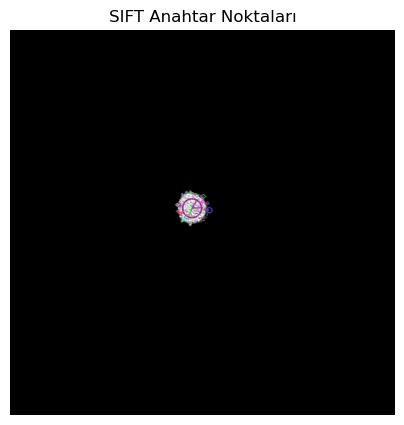

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Çıkarılan görüntüyü yükle
image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/crop/extracted_region_2025-01-23_05-01-05.jpg'  # Bunu gerçek çıkarılan görüntü yoluyla değiştirin
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Görüntünün doğru bir şekilde yüklendiğini doğrula
if image is None:
    raise ValueError("Görüntü bulunamadı veya yol hatalı")

# Anahtar noktaları çıkarmak için bir SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Anahtar noktaları ve tanımlayıcıları (descriptors) bulun
keypoints, descriptors = sift.detectAndCompute(image, None)

# Görselleştirme için anahtar noktaları görüntü üzerine çiz
keypoint_image = cv2.drawKeypoints(image, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Tespit edilen anahtar noktaların sayısını yazdır
print(f"Tespit edilen anahtar noktaların sayısı: {len(keypoints)}")

# Görüntüyü göster (matplotlib ile)
plt.figure(figsize=(5, 5))
plt.imshow(keypoint_image, cmap='gray')
plt.title('SIFT Anahtar Noktaları')
plt.axis('off')  # Eksenleri gizle
plt.show()


SIFT ON ORGINAL BUT ON REGION OF INTEREST , 
yani orjinal fotoğrafın üzerinde ama sadece organ bölgesinin KEYPOINTlerini  çıkarttık 

İlgi bölgesinde tespit edilen anahtar noktaların sayısı: 24


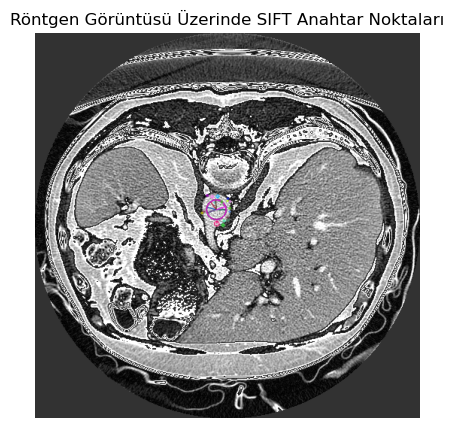

In [28]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Dosya yolları
xray_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto3.png'  # Bu, gerçek röntgen görüntüsünün yoluyla değiştirin
mask_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/foto3.png'  # Bunu gerçek maskenin yoluyla değiştirin

# Röntgen görüntüsünü ve maskeyi yükle
xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

# Görüntünün doğru bir şekilde yüklendiğini doğrula
if xray_image is None or mask_image is None:
    raise ValueError("Görüntü veya maske bulunamadı, dosya yollarını kontrol edin.")

# İlgi bölgesini elde etmek için maskeyi röntgen görüntüsüne uygula
region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

# Anahtar noktaları çıkarmak için bir SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Sadece belirlenen bölgede anahtar noktaları ve tanımlayıcıları (descriptors) bulun
keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

# Anahtar noktaları orijinal röntgen görüntüsü üzerine çiz
keypoint_image = cv2.drawKeypoints(xray_image, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Tespit edilen anahtar noktaların sayısını yazdır
print(f"İlgi bölgesinde tespit edilen anahtar noktaların sayısı: {len(keypoints)}")

# Görüntüyü göster (matplotlib ile)
plt.figure(figsize=(5, 5))
plt.imshow(keypoint_image, cmap='gray')
plt.title('Röntgen Görüntüsü Üzerinde SIFT Anahtar Noktaları')
plt.axis('off')  # Eksenleri gizle
plt.show()


SIFT ON HISTOGRAM  PHOTO USING equalizeHist  , 
anahtar noktaların kalitesini daha iyi olması için  equalizeHist uyguladıktan sonra çıkarması 

İlgi bölgesinde tespit edilen anahtar noktaların sayısı: 18


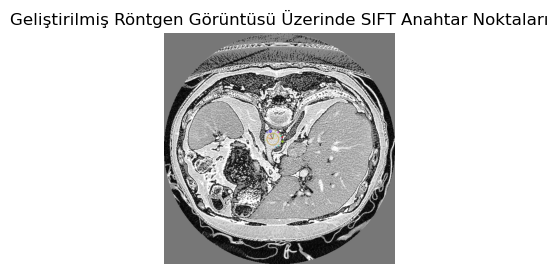

In [29]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Dosya yolları
xray_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto3.png'  # Bu, gerçek röntgen görüntüsünün yoluyla değiştirin
mask_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/foto3.png' # Gerçek maskenin yoluyla değiştirin

# Röntgen görüntüsünü ve maskeyi yükle
xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

# Görüntünün doğru bir şekilde yüklendiğini doğrula
if xray_image is None or mask_image is None:
    raise ValueError("Görüntü veya maske bulunamadı, dosya yollarını kontrol edin.")

# Histogram eşitlemesiyle röntgen görüntüsünün kontrastını iyileştir
xray_image_equalized = cv2.equalizeHist(xray_image)

# İlgi bölgesini elde etmek için maskeyi iyileştirilmiş röntgen görüntüsüne uygula
region_of_interest = cv2.bitwise_and(xray_image_equalized, xray_image_equalized, mask=mask_image)

# Anahtar noktaları çıkarmak için bir SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Sadece belirlenen bölgede anahtar noktaları ve tanımlayıcıları (descriptors) bulun
keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

# Anahtar noktaları iyileştirilmiş röntgen görüntüsü üzerine çiz
keypoint_image = cv2.drawKeypoints(xray_image_equalized, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Tespit edilen anahtar noktaların sayısını yazdır
print(f"İlgi bölgesinde tespit edilen anahtar noktaların sayısı: {len(keypoints)}")

# Görüntüyü göster (matplotlib ile)
plt.figure(figsize=(3, 3))
plt.imshow(keypoint_image, cmap='gray')
plt.title('Geliştirilmiş Röntgen Görüntüsü Üzerinde SIFT Anahtar Noktaları')
plt.axis('off')  # Eksenleri gizle
plt.show()


SIFT ON HISTOGRAM OR GAUSS OR CLAHE TO SEE WHAT IS THE BEST OPTION AND SAVING THE KEY POINTS  ,
anahtar noktaların kalitesini daha iyi olması için  equalizeHist veya clahe veya gauss uyguladıktan sonra çıkarması hangisi bana daha iyi sonuçlar vermiyi görmek için 

Tespit edilen anahtar noktaların sayısı: 30
Tanımlayıcılar 'keypoints_descriptors.npy' dosyasına kaydedildi


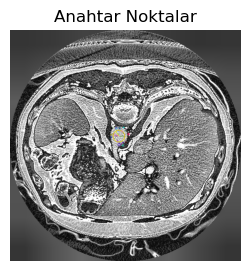

In [30]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Dosya yolları
xray_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto3.png'  # Bu, gerçek röntgen görüntüsünün yoluyla değiştirin
mask_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/foto3.png'  # Maskenin yolu

# Röntgen görüntüsünü ve maskeyi yükle
xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

# Görüntünün doğru bir şekilde yüklendiğini doğrula
if xray_image is None or mask_image is None:
    raise ValueError("Görüntü veya maske bulunamadı, dosya yollarını kontrol edin.")

# Kontrast iyileştirme 
#xray_image_equalized =  cv2.GaussianBlur(xray_image, (5, 5), 0)
#xray_image_equalized =  cv2.equalizeHist (xray_image)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
new_image_enhanced = clahe.apply(xray_image)

# Maskeyi geliştirilmiş görüntüye uygula
region_of_interest = cv2.bitwise_and(new_image_enhanced, new_image_enhanced, mask=mask_image)

# SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Anahtar noktaları ve tanımlayıcıları çıkar
keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

# Gelecekteki kullanım için tanımlayıcıları kaydet
np.save('keypoints_descriptors.npy', descriptors)

# Anahtar noktaların sayısını yazdır ve tanımlayıcıları kaydet
print(f"Tespit edilen anahtar noktaların sayısı: {len(keypoints)}")
print("Tanımlayıcılar 'keypoints_descriptors.npy' dosyasına kaydedildi")

# Anahtar noktaları görüntü üzerine çiz ve görüntüyü göster
keypoint_image = cv2.drawKeypoints(new_image_enhanced, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Görüntüyü matplotlib ile göster
plt.figure(figsize=(3, 3))
plt.imshow(keypoint_image, cmap='gray')
plt.title('Anahtar Noktalar')
plt.axis('off')  # Eksenleri gizle
plt.show()


MATCHING , 
burada yukarıda farklı düzeltmeler yaparak ( HISTOGRAM OR GAUSS OR CLAHE) çıkarılmış olan anahtar noktaları denedik farklı fotğraflarda ve en iyi sonuçlar veren yöntemi seçtik
NOT :  
fotoğraf değişmeyince bu işiemler faydalı , ama asıl amacımız bütün fotğraflarda çalışabilen kod yapmak için fotoğrafları oldukları gibi bırakmaya karar verdim çünkü bu değişimler anhtarnoktaların karışmasına neden olur 
NOT 2 : 
zaten litaratürlerde SIFT in contrasta dayanaklı olduğunu tespit etmişler 

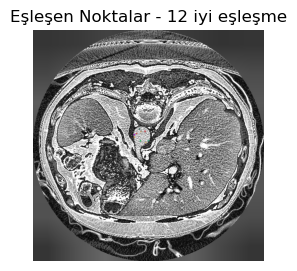

İyi eşleşme sayısı: 12


In [31]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Yeni görüntünün yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto3.png'  # Bunu gerçek yeni görüntünün yoluyla değiştirin

# Kaydedilen tanımlayıcıları (Descriptors) dosyadan yükle
descriptors_saved = np.load('keypoints_descriptors.npy')

# Yeni görüntüyü yükle
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı, dosya yolunu kontrol edin.")

# Kontrast iyileştirme (isteğe bağlı olarak etkinleştirilebilir)
#new_image_equalized = cv2.equalizeHist(new_image)
#new_image_equalized = cv2.GaussianBlur(new_image, (5, 5), 0)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
new_image_enhanced = clahe.apply(new_image)

# Yeni görüntü için bir SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Yeni görüntüden anahtar noktaları ve tanımlayıcıları çıkar
keypoints_new, descriptors_new = sift.detectAndCompute(new_image_enhanced, None)

# FLANN eşleştirici hazırlayın
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Kaydedilen noktalarla yeni görüntüdeki noktaları eşleştir
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe's ratio testi kullanarak iyi eşleşmeleri filtrele
good_matches = []
for m, n in matches:
    if m.distance < 0.8 * n.distance:
        good_matches.append(m)

# İyi eşleşmeler varsa işlemleri gerçekleştir
if len(good_matches) > 0:
    # Eşleşen noktaların listesini oluştur
    keypoints_to_draw = [keypoints_new[match.trainIdx] for match in good_matches]

    # İyi eşleşmeleri yeni görüntü üzerine çiz
    matched_image = cv2.drawKeypoints(
        new_image_enhanced, keypoints_to_draw, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
    )

    # Görüntüyü matplotlib ile göster
    plt.figure(figsize=(3, 3))
    plt.imshow(matched_image, cmap='gray')
    plt.title(f"Eşleşen Noktalar - {len(good_matches)} iyi eşleşme")
    plt.axis('off')  # Eksenleri gizle
    plt.show()

    # İyi eşleşme sayısını yazdır
    print(f"İyi eşleşme sayısı: {len(good_matches)}")
else:
    print("Hiç iyi eşleşme bulunamadı.")


TRYING ON BIG DATA 
daha fazla fotğrafların anahtar noktaları çıkarmak ve pickle yardımıyla kaydetmek 

In [32]:
import cv2
import numpy as np
import os
import pickle

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru bir şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Maskeyi görüntüye uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # SIFT nesnesi oluştur ve anahtar noktaları ile tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx]
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgi yazdır
        print(f"{file_name}: Tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"Hata oluştu: {file_name}: {e}")

# Tüm anahtar noktaları tek bir dosyaya kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar şu dosyaya kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: Tespit edilen anahtar nokta sayısı: 25
foto2.png: Tespit edilen anahtar nokta sayısı: 23
foto3.png: Tespit edilen anahtar nokta sayısı: 24
foto4.png: Tespit edilen anahtar nokta sayısı: 12
foto5.png: Tespit edilen anahtar nokta sayısı: 17
foto6.png: Tespit edilen anahtar nokta sayısı: 15
foto7.png: Tespit edilen anahtar nokta sayısı: 22
foto8.png: Tespit edilen anahtar nokta sayısı: 14
foto9.png: Tespit edilen anahtar nokta sayısı: 21
foto10.png: Tespit edilen anahtar nokta sayısı: 14
Tüm anahtar noktalar şu dosyaya kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl
Tüm görüntüler için işlem tamamlandı.


TRYING TO CATCH 
Eşleştirme işlemi 

Kaydedilen toplam anahtar nokta sayısı: 187
Yeni görüntüdeki anahtar nokta sayısı: 3036
İyi eşleşme sayısı: 5


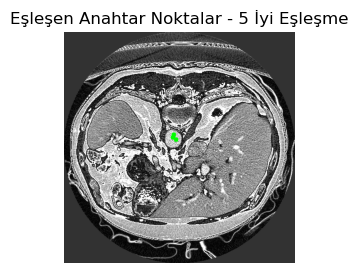

In [33]:
import cv2
import pickle
import numpy as np
import os
import matplotlib.pyplot as plt

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Gerekirse bu yolu değiştirin

# Kaydedilen verileri oku
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm kaydedilen anahtar noktaları ve tanımlayıcıları birleştir
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        # KeyPoint nesnesini yeniden oluştur
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Tanımlayıcıları NumPy dizisine dönüştür
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni görüntünün yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto1.png'  # Yeni görüntünün yolunu düzenleyin

# Yeni görüntüyü yükle
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı, dosya yolunu kontrol edin.")

# SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Yeni görüntüden anahtar noktaları ve tanımlayıcıları çıkar
keypoints_new, descriptors_new = sift.detectAndCompute(new_image, None)

print(f"Yeni görüntüdeki anahtar nokta sayısı: {len(keypoints_new)}")

# Tanımlayıcıların boş olmadığını doğrula
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Tanımlayıcılar boş. Görüntüleri ve anahtar noktaları kontrol edin.")

# FLANN matcher'ı hazırla
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN kullanarak tanımlayıcıları eşleştir
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe's ratio testi uygulayarak iyi eşleşmeleri al
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşme sayısı: {len(good_matches)}")

# Yeni görüntüdeki eşleşen noktaları çiz
if len(good_matches) > 0:
    # Yeni görüntüde eşleşen noktaları al
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]

    # Yeni görüntüyü renkliye dönüştür ve noktaları çizin
    matched_image = cv2.cvtColor(new_image, cv2.COLOR_GRAY2BGR)
    for pt in points_new:
        cv2.circle(matched_image, (int(pt[0]), int(pt[1])), 5, (0, 255, 0), -1)

    # Görüntüyü matplotlib ile göster
    plt.figure(figsize=(3, 3))
    plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Eşleşen Anahtar Noktalar - {len(good_matches)} İyi Eşleşme")
    plt.axis('off')  # Eksenleri gizle
    plt.show()
else:
    print("İyi eşleşme bulunamadı.")


TRYING TO CATCH 
Eşleştirme işlemine bazı düzeltmeler yaptık SIFT parametrelerni ayarlama gibi ve RANSAC (standart hali ) kullanmak gibi 

Kaydedilen toplam anahtar nokta sayısı: 187
Yeni görüntüdeki anahtar nokta sayısı: 2733
İyi eşleşme sayısı: 3
Yeterli eşleşme yok. Homografi hesaplanamadı.


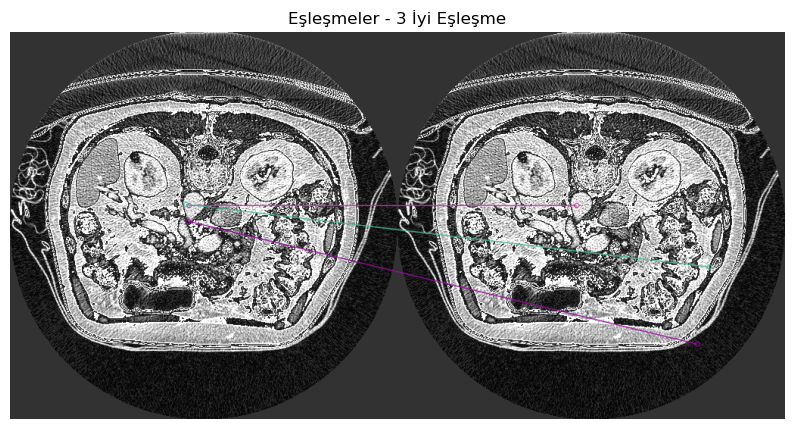

In [34]:
import cv2
import pickle
import numpy as np
import matplotlib.pyplot as plt

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'

# Kaydedilen verileri oku
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm kaydedilen anahtar noktaları ve tanımlayıcıları birleştir
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Tanımlayıcıları NumPy dizisine dönüştür
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni görüntünün yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto5.png'

# Yeni görüntüyü yükle
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı, dosya yolunu kontrol edin.")

# SIFT nesnesi oluştur
sift = cv2.SIFT_create(nfeatures=8000, contrastThreshold=0.03, edgeThreshold=10, sigma=1.6)

# Yeni görüntüden anahtar noktaları ve tanımlayıcıları çıkar
keypoints_new, descriptors_new = sift.detectAndCompute(new_image, None)

print(f"Yeni görüntüdeki anahtar nokta sayısı: {len(keypoints_new)}")

# Tanımlayıcıların boş olmadığını doğrula
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Tanımlayıcılar boş. Görüntüleri ve anahtar noktaları kontrol edin.")

# FLANN matcher'ı hazırla
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=10)
search_params = dict(checks=100)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN kullanarak tanımlayıcıları eşleştir
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe's ratio testi uygulayarak iyi eşleşmeleri al
good_matches = []
for m, n in matches:
    if m.distance < 0.7 * n.distance:  # Oranı 0.7 olarak ayarlandı
        good_matches.append(m)

print(f"İyi eşleşme sayısı: {len(good_matches)}")

# Eşleşme sayısını kontrol et ve homografi hesapla
if len(good_matches) >= 4:
    # İyi eşleşme noktalarını ayıkla
    src_pts = np.float32([keypoints_saved[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints_new[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    # Homografiyi hesapla
    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    matches_mask = mask.ravel().tolist()

    print("Homografi hesaplandı.")
    print("Homografi matrisi:")
    print(H)
else:
    print("Yeterli eşleşme yok. Homografi hesaplanamadı.")

# Eşleşen noktaları görselleştir
matched_image = cv2.drawMatches(
    cv2.imread(new_image_path),
    keypoints_saved,
    new_image,
    keypoints_new,
    good_matches,
    None,
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
)

# Matplotlib ile eşleşmeleri göster
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
plt.title(f"Eşleşmeler - {len(good_matches)} İyi Eşleşme")
plt.axis('off')
plt.show()


TRYING ON BIG DATA + LBP 

fotğrafların anahtar noktaları çıkarmak ama LBP (local binary pattern) uyguladıktan sonra , burada bütün fotoğrafa LBP uyguluyorum sonra anahtar noktarları çıkarıyoruz , 

In [35]:
import cv2
import numpy as np
import os
import pickle
from skimage.feature import local_binary_pattern

# LBP ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru bir şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Maskeyi görüntüye uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # İlgi bölgesine LBP uygula
        lbp = local_binary_pattern(region_of_interest, n_points, radius, METHOD)

        # LBP sonucunu normalize et
        lbp_normalized = cv2.normalize(lbp, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

        # SIFT nesnesi oluştur ve LBP üzerinden anahtar noktaları ile tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(lbp_normalized, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx]
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgi yazdır
        print(f"{file_name}: LBP ile tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"Hata oluştu: {file_name}: {e}")

# Tüm anahtar noktaları tek bir dosyaya kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar şu dosyaya kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: LBP ile tespit edilen anahtar nokta sayısı: 32
foto2.png: LBP ile tespit edilen anahtar nokta sayısı: 41
foto3.png: LBP ile tespit edilen anahtar nokta sayısı: 32
foto4.png: LBP ile tespit edilen anahtar nokta sayısı: 20
foto5.png: LBP ile tespit edilen anahtar nokta sayısı: 15
foto6.png: LBP ile tespit edilen anahtar nokta sayısı: 14
foto7.png: LBP ile tespit edilen anahtar nokta sayısı: 19
foto8.png: LBP ile tespit edilen anahtar nokta sayısı: 17
foto9.png: LBP ile tespit edilen anahtar nokta sayısı: 13
foto10.png: LBP ile tespit edilen anahtar nokta sayısı: 14
Tüm anahtar noktalar şu dosyaya kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl
Tüm görüntüler için işlem tamamlandı.


trying to catch 
SIFT + LBP de çıkarlmış olan anahtar noktalırı eşleştirmesi 
NOT :
LBP, dataının içinde bulunan fotoğraflar için yani bunların anahtar noktaları çıkartmış olduğumuz fotoğraflar için en iyi sonuçlar verdi, ama asıl amacımız bütün fotğraflarda çalışabilen kod yani hocamız,  anhtar noktaları yakalamış olduğumuz fotoğrafların dışında denemk istediği için başka yöntemler denedik

Kaydedilen toplam anahtar nokta sayısı: 217
Yeni görüntüdeki anahtar nokta sayısı (LBP sonrası): 5051
İyi eşleşme sayısı: 6


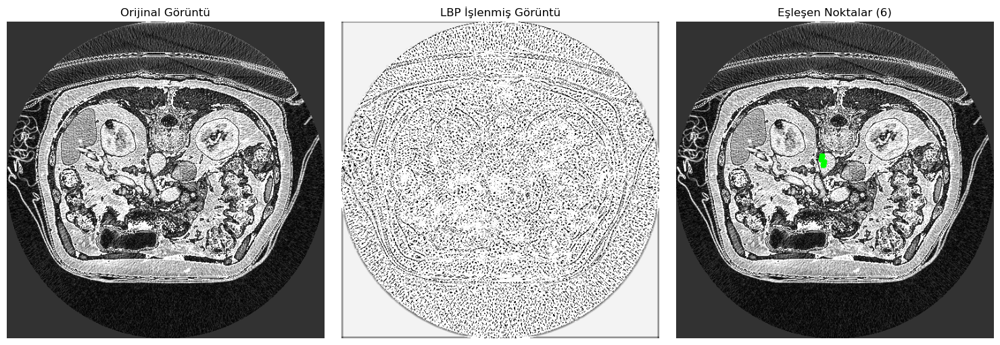

In [36]:
import cv2
import pickle
import numpy as np
import os
from skimage.feature import local_binary_pattern
import matplotlib.pyplot as plt

# LBP ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Gerekirse bu yolu değiştirin

# Kaydedilen verileri oku
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm kaydedilen anahtar noktaları ve tanımlayıcıları birleştir
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Tanımlayıcıları NumPy dizisine dönüştür
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni görüntünün yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto5.png'  # Yeni görüntünün yolunu düzenleyin

# Yeni görüntüyü yükle
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı, dosya yolunu kontrol edin.")

# Yeni görüntüye LBP uygula
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunu normalize et
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Yeni LBP görüntüsünden anahtar noktaları ve tanımlayıcıları çıkar
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni görüntüdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# Tanımlayıcıların boş olmadığını doğrula
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Tanımlayıcılar boş. Görüntüleri ve anahtar noktaları kontrol edin.")

# FLANN matcher hazırlayın
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN kullanarak tanımlayıcıları eşleştir
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe's ratio testi uygulayarak iyi eşleşmeleri al
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşme sayısı: {len(good_matches)}")

# Yeni görüntüde eşleşen noktaları çiz
if len(good_matches) > 0:
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]
    matched_image = cv2.cvtColor(new_image, cv2.COLOR_GRAY2BGR)
    for pt in points_new:
        cv2.circle(matched_image, (int(pt[0]), int(pt[1])), 5, (0, 255, 0), -1)

# Görselleri yan yana göster
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Orijinal görüntü
axs[0].imshow(new_image, cmap='gray')
axs[0].set_title("Orijinal Görüntü")
axs[0].axis('off')

# LBP ile işlenmiş görüntü
axs[1].imshow(lbp_normalized, cmap='gray')
axs[1].set_title("LBP İşlenmiş Görüntü")
axs[1].axis('off')

# Eşleşen anahtar noktalar
if len(good_matches) > 0:
    axs[2].imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
    axs[2].set_title(f"Eşleşen Noktalar ({len(good_matches)})")
else:
    axs[2].imshow(new_image, cmap='gray')
    axs[2].set_title("Eşleşme Bulunamadı")
axs[2].axis('off')

plt.tight_layout()
plt.show()


bütün fotoğrafa LBP uygulamak yerine , sift ile çıkarılmış anahtar noktalar üzerinde patch alarak LBP özellikleri SIFT'e eklenmesi 

In [37]:
import cv2
import numpy as np
import os
import pickle
from skimage.feature import local_binary_pattern

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.lbp.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru bir şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Maskeyi görüntüye uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # SIFT nesnesi oluştur ve anahtar noktaları ile tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                # LBP özelliklerini çıkar
                x, y = int(kp.pt[0]), int(kp.pt[1])
                patch_size = max(min(int(kp.size * 1.5), 32), 2)  # Yama boyutunu minimum 2 olarak ayarla
                x_start = max(x - patch_size // 2, 0)
                x_end = min(x + patch_size // 2, region_of_interest.shape[1])
                y_start = max(y - patch_size // 2, 0)
                y_end = min(y + patch_size // 2, region_of_interest.shape[0])
                patch = region_of_interest[y_start:y_end, x_start:x_end]

                # LBP'yi çıkarmak için yamanın boyutunu kontrol et
                if patch.shape[0] >= 16 and patch.shape[1] >= 16:
                    radius = 1
                    n_points = 8 * radius
                    lbp = local_binary_pattern(patch, n_points, radius, method='uniform')
                    lbp_hist, _ = np.histogram(lbp, bins=np.arange(0, n_points + 3), density=True)
                else:
                    lbp_hist = np.array([])

                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx],
                    'lbp_features': lbp_hist
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgi yazdır
        print(f"{file_name}: Tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"Hata oluştu: {file_name}: {e}")

# Tüm anahtar noktaları tek bir dosyaya kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar şu dosyaya kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: Tespit edilen anahtar nokta sayısı: 25
foto2.png: Tespit edilen anahtar nokta sayısı: 23
foto3.png: Tespit edilen anahtar nokta sayısı: 24
foto4.png: Tespit edilen anahtar nokta sayısı: 12
foto5.png: Tespit edilen anahtar nokta sayısı: 17
foto6.png: Tespit edilen anahtar nokta sayısı: 15
foto7.png: Tespit edilen anahtar nokta sayısı: 22
foto8.png: Tespit edilen anahtar nokta sayısı: 14
foto9.png: Tespit edilen anahtar nokta sayısı: 21
foto10.png: Tespit edilen anahtar nokta sayısı: 14
Tüm anahtar noktalar şu dosyaya kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.lbp.pkl
Tüm görüntüler için işlem tamamlandı.


PATCH CATCH 
bu anahtar noktaları fotoğraf üzerinde denemk 

Geçerli eşleşme sayısı: 7


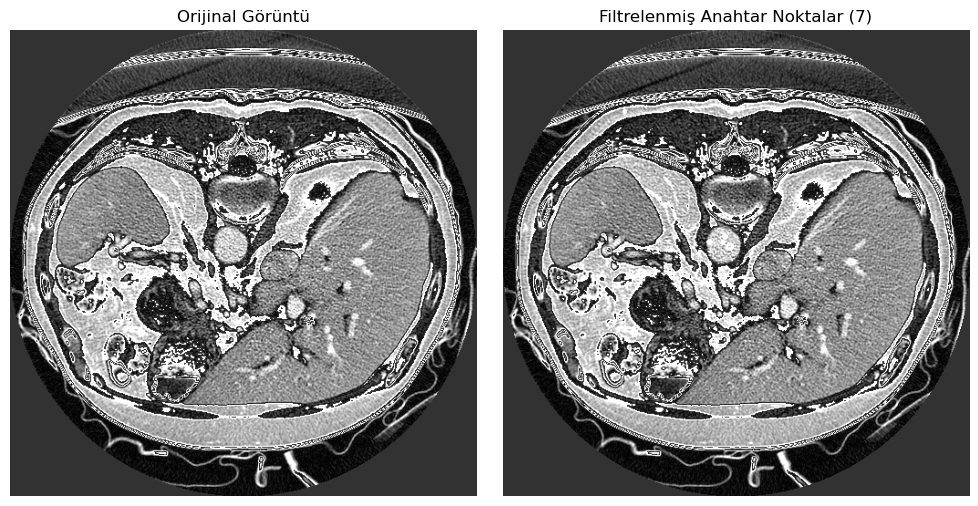

In [38]:
import cv2
import numpy as np
import pickle
from skimage.feature import local_binary_pattern
import matplotlib.pyplot as plt

# Kaydedilen verileri yükle
with open('C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.lbp.pkl', 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen verilerden tanımlayıcıları ve LBP özelliklerini çıkar
all_descriptors = []
all_lbp_features = []
keypoints_store = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp in keypoints_list:
        all_descriptors.append(kp['descriptor'])
        all_lbp_features.append(kp['lbp_features'] if len(kp['lbp_features']) > 0 else np.zeros(59))  # 'uniform' için 59
        keypoints_store.append((kp['pt'][0], kp['pt'][1]))

# Tüm LBP özelliklerinin aynı uzunlukta olduğundan emin ol
fixed_lbp_length = 59  # 'uniform' yöntemiyle standart uzunluk
all_lbp_features = [
    np.pad(lbp, (0, fixed_lbp_length - len(lbp)), 'constant') if len(lbp) < fixed_lbp_length else lbp
    for lbp in all_lbp_features
]

all_descriptors = np.vstack(all_descriptors)
all_lbp_features = np.vstack(all_lbp_features)

# FLANN eşleştirme ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=200)
search_params = dict(checks=500)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Yeni görüntüyü yükle
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto1.png'
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
sift = cv2.SIFT_create()
new_keypoints, new_descriptors = sift.detectAndCompute(new_image, None)

# Yeni görüntü için LBP özelliklerini çıkar
new_lbp_features = []
for kp in new_keypoints:
    x, y = int(kp.pt[0]), int(kp.pt[1])
    patch_size = max(min(int(kp.size * 1.5), 32), 2)
    x_start = max(x - patch_size // 2, 0)
    x_end = min(x + patch_size // 2, new_image.shape[1])
    y_start = max(y - patch_size // 2, 0)
    y_end = min(y + patch_size // 2, new_image.shape[0])
    patch = new_image[y_start:y_end, x_start:x_end]

    # Yamanın boyutunu kontrol et ve LBP çıkar
    if patch.shape[0] >= 16 and patch.shape[1] >= 16:
        radius = 1
        n_points = 8 * radius
        lbp = local_binary_pattern(patch, n_points, radius, method='uniform')
        lbp_hist, _ = np.histogram(lbp, bins=np.arange(0, n_points + 3), density=True)
    else:
        lbp_hist = np.zeros(fixed_lbp_length)  # Standart uzunluk ile eşleş

    new_lbp_features.append(lbp_hist)

# Yeni LBP özelliklerinin standart uzunlukta olduğundan emin ol
new_lbp_features = [
    np.pad(lbp_hist, (0, fixed_lbp_length - len(lbp_hist)), 'constant') if len(lbp_hist) < fixed_lbp_length else lbp_hist
    for lbp_hist in new_lbp_features
]

new_descriptors = np.array(new_descriptors)
new_lbp_features = np.vstack(new_lbp_features)

# SIFT ve LBP özelliklerini birleştir
new_features = np.hstack((new_descriptors, new_lbp_features))
all_features = np.hstack((all_descriptors, all_lbp_features))

# FLANN kullanarak eşleştirme ve en yakın komşu kontrolü
matches = flann.knnMatch(new_features.astype(np.float32), all_features.astype(np.float32), k=2)

# Lowe oranı testi uygula
good_matches = []
for m, n in matches:
    if m.distance < 0.7 * n.distance:
        good_matches.append(m)

# Anahtar noktaları görüntü üzerinde çiz
filtered_image = new_image.copy()
if good_matches:
    print(f"Geçerli eşleşme sayısı: {len(good_matches)}")
    for match in good_matches:
        kp = new_keypoints[match.queryIdx]
        cv2.circle(filtered_image, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size), (255, 255, 255), 2)
else:
    print("Geçerli eşleşme bulunamadı.")

# Görselleri yan yana göster
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# Orijinal görüntü
axs[0].imshow(new_image, cmap='gray')
axs[0].set_title("Orijinal Görüntü")
axs[0].axis('off')

# Anahtar noktaları içeren görüntü
axs[1].imshow(filtered_image, cmap='gray')
axs[1].set_title(f"Filtrelenmiş Anahtar Noktalar ({len(good_matches)})")
axs[1].axis('off')

plt.tight_layout()
plt.show()


GABOR filter
fotğrafların anahtar noktaları çıkarmak ama gabor filters uyguladıktan sonra 

bu yöntem en iyi sonuçlar vermez çünkü bütün fotoğrafa GABOR yapılır sonra noktalar yakalanır 

In [39]:
import cv2
import numpy as np
import os
import pickle

# Gabor filtreleri oluşturma fonksiyonu
def build_gabor_filters():
    filters = []
    ksize = 31
    for theta in np.arange(0, np.pi, np.pi / 4):
        params = {'ksize': (ksize, ksize), 'sigma': 4.0, 'theta': theta, 'lambd': 10.0,
                'gamma': 0.5, 'psi': 0, 'ktype': cv2.CV_32F}
        filt = cv2.getGaborKernel(**params)
        filters.append(filt)
    return filters

# Görüntüye filtre uygulama
def apply_gabor_filters(image, filters):
    accum = np.zeros_like(image, dtype=np.float32)
    for filt in filters:
        fimg = cv2.filter2D(image, cv2.CV_32F, filt)
        np.maximum(accum, fimg, accum)
    return accum

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]
# Tüm anahtar noktaları ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

# Gabor filtreleri oluşturma
filters = build_gabor_filters()

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru bir şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Gabor filtrelerini röntgen görüntüsüne uygula
        gabor_response = apply_gabor_filters(xray_image, filters)

        # Gabor sonucu normalize et
        gabor_normalized = cv2.normalize(gabor_response, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

        # İlgi bölgesini elde etmek için maskeyi uygula
        region_of_interest = cv2.bitwise_and(gabor_normalized, gabor_normalized, mask=mask_image)

        # SIFT nesnesi oluştur ve anahtar noktaları ile tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx]
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgi yazdır
        print(f"{file_name}: Tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"Hata oluştu: {file_name}: {e}")

# Tüm anahtar noktaları tek bir dosyaya kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar şu dosyaya kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: Tespit edilen anahtar nokta sayısı: 17
foto2.png: Tespit edilen anahtar nokta sayısı: 11
foto3.png: Tespit edilen anahtar nokta sayısı: 7
foto4.png: Tespit edilen anahtar nokta sayısı: 13
foto5.png: Tespit edilen anahtar nokta sayısı: 15
foto6.png: Tespit edilen anahtar nokta sayısı: 12
foto7.png: Tespit edilen anahtar nokta sayısı: 11
foto8.png: Tespit edilen anahtar nokta sayısı: 16
foto9.png: Tespit edilen anahtar nokta sayısı: 20
foto10.png: Tespit edilen anahtar nokta sayısı: 10
Tüm anahtar noktalar şu dosyaya kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl
Tüm görüntüler için işlem tamamlandı.


TRYING TO CATCH + GABOR 

çıkarılmış noktaları fotoğraf üzerinde denemek 

Kaydedilen toplam anahtar nokta sayısı: 132
Yeni görüntüdeki anahtar nokta sayısı: 1594
İyi eşleşme sayısı: 1


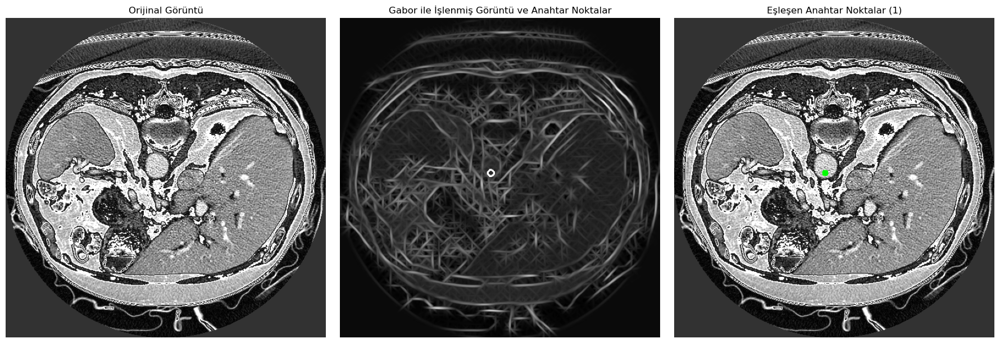

In [40]:
import cv2
import numpy as np
import pickle
import matplotlib.pyplot as plt

# Gabor filtrelerini oluşturma fonksiyonu
def build_gabor_filters():
    filters = []
    ksize = 31
    for theta in np.arange(0, np.pi, np.pi / 4):
        params = {'ksize': (ksize, ksize), 'sigma': 4.0, 'theta': theta, 'lambd': 10.0,
                'gamma': 0.5, 'psi': 0, 'ktype': cv2.CV_32F}
        filt = cv2.getGaborKernel(**params)
        filters.append(filt)
    return filters

# Görüntüye filtreleri uygula
def apply_gabor_filters(image, filters):
    accum = np.zeros_like(image, dtype=np.float32)
    for filt in filters:
        fimg = cv2.filter2D(image, cv2.CV_32F, filt)
        np.maximum(accum, fimg, accum)
    return accum

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Gerekirse bu yolu düzenleyin

# Kaydedilen verileri oku
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm kaydedilen anahtar noktaları ve tanımlayıcıları birleştir
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        # KeyPoint nesnesini yeniden oluştur
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Tanımlayıcıları NumPy dizisine dönüştür
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni görüntünün yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto1.png'  # Yeni görüntünün yolunu düzenleyin

# Yeni görüntüyü yükle
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı, dosya yolunu kontrol edin.")

# Yeni görüntüye Gabor filtreleri uygula
filters = build_gabor_filters()
gabor_response = apply_gabor_filters(new_image, filters)

# Gabor sonucu normalize et
gabor_normalized = cv2.normalize(gabor_response, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Gabor ile geliştirilmiş görüntüden anahtar noktaları ve tanımlayıcıları çıkar
keypoints_new, descriptors_new = sift.detectAndCompute(gabor_normalized, None)

print(f"Yeni görüntüdeki anahtar nokta sayısı: {len(keypoints_new)}")

# Tanımlayıcıların boş olmadığını doğrula
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Tanımlayıcılar boş. Görüntüleri ve anahtar noktaları kontrol edin.")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN kullanarak tanımlayıcıları eşleştir
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oranı testi uygula
good_matches = []
for m, n in matches:
    if m.distance < 0.65 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşme sayısı: {len(good_matches)}")

# Eşleşen anahtar noktaları görüntü üzerinde çiz
matched_image = cv2.cvtColor(new_image, cv2.COLOR_GRAY2BGR)
gabor_keypoint_image = gabor_normalized.copy()
if len(good_matches) > 0:
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]
    for pt in points_new:
        cv2.circle(matched_image, (int(pt[0]), int(pt[1])), 5, (0, 255, 0), -1)
        cv2.circle(gabor_keypoint_image, (int(pt[0]), int(pt[1])), 5, (255, 255, 255), 2)
else:
    print("İyi eşleşme bulunamadı.")

# Görselleri yan yana göster
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# Orijinal görüntü
axs[0].imshow(new_image, cmap='gray')
axs[0].set_title("Orijinal Görüntü")
axs[0].axis('off')

# Gabor ile işlenmiş görüntü
axs[1].imshow(gabor_keypoint_image, cmap='gray')
axs[1].set_title("Gabor ile İşlenmiş Görüntü ve Anahtar Noktalar")
axs[1].axis('off')

# Eşleşen noktalarla birlikte görüntü
axs[2].imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
axs[2].set_title(f"Eşleşen Anahtar Noktalar ({len(good_matches)})")
axs[2].axis('off')

plt.tight_layout()
plt.show()


PATCH GABOR 
bütün fotoğrafa GABOR uygulamak yerine , sift ile çıkarılmış anahtar noktalar üzerinde patch alarak GABOR özellikleri SIFT'e eklenmesi 


In [41]:
import cv2
import numpy as np
import os
import pickle
from scipy.ndimage import convolve

# Gabor filtresi oluşturma fonksiyonu
def create_gabor_filter(kernel_size=31, sigma=4.0, theta=0, frequency=0.2):
    """
    Gabor filtresi çekirdeği oluşturur.
    """
    x, y = np.meshgrid(
        np.arange(-kernel_size // 2 + 1, kernel_size // 2 + 1),
        np.arange(-kernel_size // 2 + 1, kernel_size // 2 + 1)
    )
    x_theta = x * np.cos(theta) + y * np.sin(theta)
    y_theta = -x * np.sin(theta) + y * np.cos(theta)
    gabor = np.exp(-0.5 * (x_theta**2 + y_theta**2) / sigma**2) * np.cos(2 * np.pi * frequency * x_theta)
    return gabor

# Gabor filtrelerini önceden ayarlama (farklı frekanslar ve açılar ile)
gabor_filters = []
for sigma in [2.0, 4.0, 6.0]:  # Farklı ölçekler
    for frequency in [0.1, 0.2, 0.3]:  # Farklı frekanslar
        for theta in np.linspace(0, np.pi, 12):  # 12 farklı yön
            gabor_filters.append(create_gabor_filter(kernel_size=31, sigma=sigma, theta=theta, frequency=frequency))

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.gabor.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru bir şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Görüntüye maskeyi uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # SIFT nesnesi oluştur ve anahtar noktaları ile tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                # Gabor özelliklerini çıkar
                x, y = int(kp.pt[0]), int(kp.pt[1])
                patch_size = max(min(int(kp.size * 1.5), 32), 2)  # Yama boyutunu minimum 2 olarak ayarla
                x_start = max(x - patch_size // 2, 0)
                x_end = min(x + patch_size // 2, region_of_interest.shape[1])
                y_start = max(y - patch_size // 2, 0)
                y_end = min(y + patch_size // 2, region_of_interest.shape[0])
                patch = region_of_interest[y_start:y_end, x_start:x_end]

                # Gabor özelliklerini çıkarmak için yamanın boyutunu kontrol et
                if patch.shape[0] >= 16 and patch.shape[1] >= 16:
                    gabor_responses = []
                    for gabor_filter in gabor_filters:
                        response = convolve(patch, gabor_filter)
                        gabor_responses.append(np.mean(response))  # Ortalama
                        gabor_responses.append(np.std(response))   # Standart sapma
                        gabor_responses.append(np.sum(response**2))  # Enerji
                    gabor_features = np.array(gabor_responses)
                else:
                    gabor_features = np.array([])

                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx],
                    'gabor_features': gabor_features
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgi yazdır
        print(f"{file_name}: Tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"Hata oluştu: {file_name}: {e}")

# Tüm anahtar noktaları tek bir dosyaya kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar şu dosyaya kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: Tespit edilen anahtar nokta sayısı: 25
foto2.png: Tespit edilen anahtar nokta sayısı: 23
foto3.png: Tespit edilen anahtar nokta sayısı: 24
foto4.png: Tespit edilen anahtar nokta sayısı: 12
foto5.png: Tespit edilen anahtar nokta sayısı: 17
foto6.png: Tespit edilen anahtar nokta sayısı: 15
foto7.png: Tespit edilen anahtar nokta sayısı: 22
foto8.png: Tespit edilen anahtar nokta sayısı: 14
foto9.png: Tespit edilen anahtar nokta sayısı: 21
foto10.png: Tespit edilen anahtar nokta sayısı: 14
Tüm anahtar noktalar şu dosyaya kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.gabor.pkl
Tüm görüntüler için işlem tamamlandı.


patch + gabor 

anahtar noktaları fotoğraf üzerinde denemek 

Geçerli eşleşme sayısı: 3


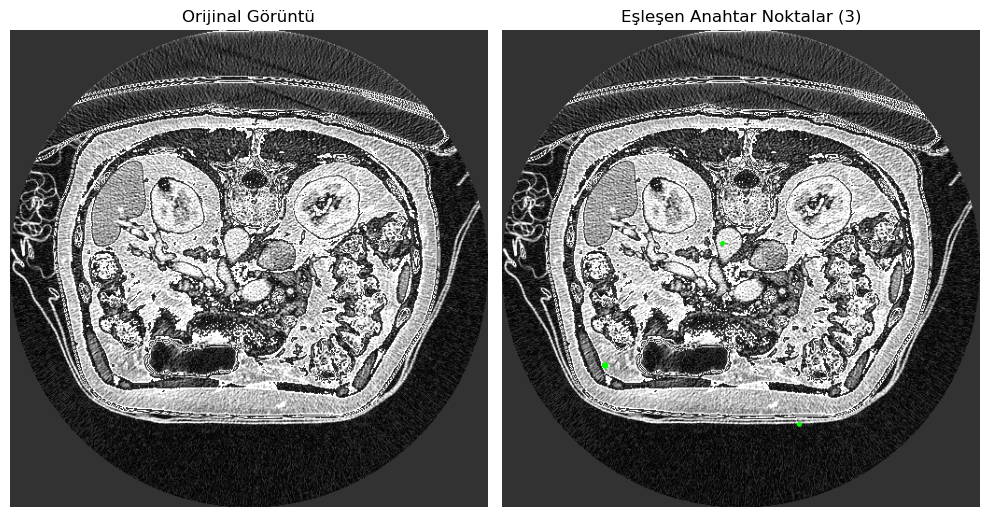

In [42]:
import cv2
import numpy as np
import pickle
import matplotlib.pyplot as plt
from scipy.ndimage import convolve

# Kaydedilen verileri yükle
with open('C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.gabor.pkl', 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen Gabor özellikleri ve tanımlayıcıları çıkar
all_descriptors = []
all_gabor_features = []
keypoints_store = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp in keypoints_list:
        all_descriptors.append(kp['descriptor'])
        all_gabor_features.append(kp['gabor_features'] if len(kp['gabor_features']) > 0 else np.zeros(36))  # Gerekirse boyutu düzenleyin
        keypoints_store.append((kp['pt'][0], kp['pt'][1]))

# Gabor özelliklerinin maksimum uzunluğunu belirle ve tüm özellikleri standart hale getir
max_gabor_length = max(len(gabor) for gabor in all_gabor_features)
all_gabor_uniform = [
    np.pad(gabor, (0, max_gabor_length - len(gabor)), 'constant', constant_values=0) if len(gabor) < max_gabor_length else gabor
    for gabor in all_gabor_features
]

all_descriptors = np.vstack(all_descriptors)
all_gabor_uniform = np.vstack(all_gabor_uniform)

# FLANN için ayarlar
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=200)
search_params = dict(checks=500)

flann = cv2.FlannBasedMatcher(index_params, search_params)

# Yeni görüntüyü yükle ve anahtar noktalarını çıkar
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto5.png'
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
sift = cv2.SIFT_create()
new_keypoints, new_descriptors = sift.detectAndCompute(new_image, None)

# Yeni görüntü için Gabor özelliklerini çıkar
def extract_gabor_features(patch, gabor_filters):
    gabor_responses = []
    for gabor_filter in gabor_filters:
        response = convolve(patch, gabor_filter)
        gabor_responses.append(np.mean(response))  # Ortalama
        gabor_responses.append(np.std(response))   # Standart sapma
        gabor_responses.append(np.sum(response**2))  # Enerji
    return np.array(gabor_responses)

# Gabor filtrelerini oluştur
gabor_filters = []
for sigma in [2.0, 4.0, 6.0]:  # Farklı ölçekler
    for frequency in [0.1, 0.2, 0.3]:  # Farklı frekanslar
        for theta in np.linspace(0, np.pi, 12):  # 12 farklı yön
            gabor_filters.append(create_gabor_filter(kernel_size=31, sigma=sigma, theta=theta, frequency=frequency))

new_gabor_features = []
for kp in new_keypoints:
    x, y = int(kp.pt[0]), int(kp.pt[1])
    patch_size = max(min(int(kp.size * 1.5), 32), 2)
    x_start = max(x - patch_size // 2, 0)
    x_end = min(x + patch_size // 2, new_image.shape[1])
    y_start = max(y - patch_size // 2, 0)
    y_end = min(y + patch_size // 2, new_image.shape[0])
    patch = new_image[y_start:y_end, x_start:x_end]

    if patch.shape[0] >= 16 and patch.shape[1] >= 16:
        gabor_features = extract_gabor_features(patch, gabor_filters)
        gabor_features = np.pad(gabor_features, (0, max_gabor_length - len(gabor_features)), 'constant', constant_values=0)
    else:
        gabor_features = np.zeros(max_gabor_length)
    new_gabor_features.append(gabor_features)

new_descriptors = np.array(new_descriptors)
new_gabor_features = np.vstack(new_gabor_features)
new_features = np.hstack((new_descriptors, new_gabor_features))

# Tüm verileri ve yeni görüntü özelliklerini birleştir
all_features = np.hstack((all_descriptors, all_gabor_uniform))

# FLANN ile eşleşme ve en yakın komşu arama
matches = flann.knnMatch(new_features.astype(np.float32), all_features.astype(np.float32), k=2)

# Lowe oranı testi
good_matches = []
for m, n in matches:
    if m.distance < 0.7 * n.distance:
        good_matches.append(m)

# Anahtar noktaları eşleşmeleri görüntüye çiz
matched_image = cv2.cvtColor(new_image, cv2.COLOR_GRAY2BGR)
if good_matches:
    print(f"Geçerli eşleşme sayısı: {len(good_matches)}")
    for match in good_matches:
        kp = new_keypoints[match.queryIdx]
        cv2.circle(matched_image, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size), (0, 255, 0), 2)
else:
    print("Geçerli eşleşme bulunamadı.")

# Görselleri matplotlib ile göster
plt.figure(figsize=(10, 6))

# Orijinal görüntü
plt.subplot(1, 2, 1)
plt.imshow(new_image, cmap='gray')
plt.title("Orijinal Görüntü")
plt.axis('off')

# Eşleşen anahtar noktalar
plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
plt.title(f"Eşleşen Anahtar Noktalar ({len(good_matches)})")
plt.axis('off')

plt.tight_layout()
plt.show()


 Wavelet Transform
fotğrafların anahtar noktaları çıkarmak ama  Wavelet Transform filters uyguladıktan sonra 

bu yöntem en iyi sonuçlar vermez çünkü bütün fotoğrafa  Wavelet Transform yapılır sonra noktalar yakalanır 


In [43]:
import cv2
import numpy as np
import os
import pickle
import pywt

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_wavelet.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru bir şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Görüntüye dalgacık dönüşümü uygula
        coeffs2 = pywt.dwt2(xray_image, 'haar')  # Haar Wavelet kullanılıyor
        LL, (LH, HL, HH) = coeffs2

        # Ayrıntı bileşenlerinden bir görüntü yeniden oluştur
        wavelet_image = np.sqrt(LH**2 + HL**2 + HH**2)

        # Çıktı görüntüsünü 0 ile 255 arasında normalize et
        wavelet_image = cv2.normalize(wavelet_image, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

        # Çıktı görüntüsünü orijinal görüntü boyutlarına yeniden boyutlandır
        wavelet_image = cv2.resize(wavelet_image, (xray_image.shape[1], xray_image.shape[0]))

        # Maske ile dalgacık dönüşümüyle iyileştirilmiş görüntüden ilgi alanını al
        region_of_interest = cv2.bitwise_and(wavelet_image, wavelet_image, mask=mask_image)

        # SIFT nesnesi oluştur ve anahtar noktaları ile tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx]
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgi yazdır
        print(f"{file_name}: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"Hata oluştu: {file_name}: {e}")

# Tüm anahtar noktaları tek bir dosyaya kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar şu dosyaya kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 42
foto2.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 42
foto3.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 42
foto4.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 32
foto5.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 26
foto6.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 27
foto7.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 29
foto8.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 25
foto9.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 24
foto10.png: Dalgacık dönüşümünden sonra tespit edilen anahtar nokta sayısı: 35
Tüm anahtar noktalar şu dosyaya kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_wavelet.pkl
Tüm görüntüler için işlem tamamlandı.


TRYING TO CATCH + Wavelet Transform
anahtar noktaları fotoğraf üzerinde yakalamak 

Kaydedilen toplam anahtar nokta sayısı: 324
Yeni görüntüdeki anahtar nokta sayısı: 5754
İyi eşleşme sayısı: 5


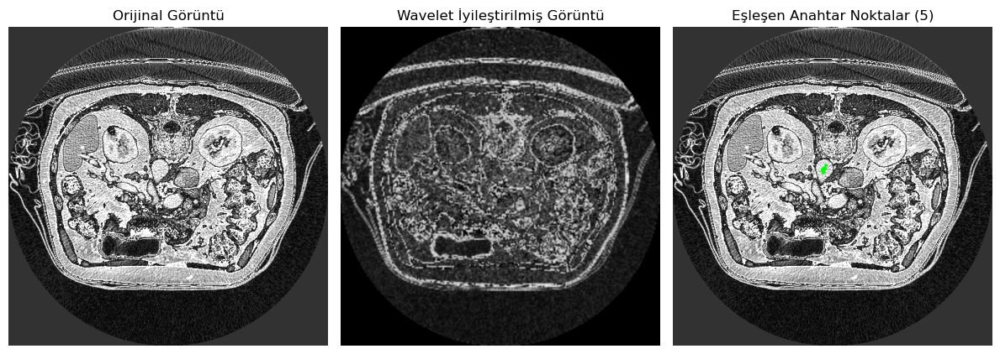

In [44]:
import cv2
import pickle
import numpy as np
import pywt
import matplotlib.pyplot as plt

# Kaydedilen anahtar nokta dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_wavelet.pkl'  # Gerekirse bu yolu düzenleyin

# Kaydedilen verileri yükle
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm görüntülerden anahtar noktaları ve tanımlayıcıları birleştir
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        # KeyPoint nesnesini yeniden oluştur
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Tanımlayıcıları NumPy dizisine dönüştür
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni görüntü yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto5.png'  # Bu yolu yeni görüntünüzle düzenleyin

# Yeni görüntüyü yükle
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı. Dosya yolunu kontrol edin.")

# Yeni görüntüye Wavelet Transform uygula
coeffs2 = pywt.dwt2(new_image, 'haar')  # Haar Wavelet kullanılıyor
LL, (LH, HL, HH) = coeffs2

# Ayrıntı bileşenlerinden bir görüntü oluştur
wavelet_image = np.sqrt(LH**2 + HL**2 + HH**2)

# Çıktı görüntüsünü 0 ile 255 arasında normalize et
wavelet_image = cv2.normalize(wavelet_image, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# Çıktı görüntüsünü orijinal görüntü boyutlarına yeniden boyutlandır
wavelet_image = cv2.resize(wavelet_image, (new_image.shape[1], new_image.shape[0]))

# SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Wavelet Transform sonrası yeni görüntüden anahtar noktaları ve tanımlayıcıları çıkar
keypoints_new, descriptors_new = sift.detectAndCompute(wavelet_image, None)

print(f"Yeni görüntüdeki anahtar nokta sayısı: {len(keypoints_new)}")

# Tanımlayıcıların boş olmadığını doğrula
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Tanımlayıcılar boş. Görüntüleri ve anahtar noktaları kontrol edin.")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Tanımlayıcıları KNN ile eşleştir
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oranı testiyle iyi eşleşmeleri seç
good_matches = []
for m, n in matches:
    if m.distance < 0.65 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşme sayısı: {len(good_matches)}")

# İyi eşleşen anahtar noktaları görüntüye çiz
matched_image = cv2.cvtColor(new_image, cv2.COLOR_GRAY2BGR)
if len(good_matches) > 0:
    for match in good_matches:
        kp = keypoints_new[match.trainIdx]
        cv2.circle(matched_image, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size), (0, 255, 0), 2)

# Görselleri matplotlib ile göster
plt.figure(figsize=(12, 6))

# Orijinal görüntü
plt.subplot(1, 3, 1)
plt.imshow(new_image, cmap='gray')
plt.title("Orijinal Görüntü")
plt.axis('off')

# Wavelet ile iyileştirilmiş görüntü
plt.subplot(1, 3, 2)
plt.imshow(wavelet_image, cmap='gray')
plt.title("Wavelet İyileştirilmiş Görüntü")
plt.axis('off')

# Anahtar noktaları eşleşmeleri
plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
plt.title(f"Eşleşen Anahtar Noktalar ({len(good_matches)})")
plt.axis('off')

plt.tight_layout()
plt.show()


patch wavelet transform 
bütün fotoğrafa wavelet transform  uygulamak yerine , sift ile çıkarılmış anahtar noktalar üzerinde patch alarak wavelet transform  özellikleri SIFT'e eklenmesi 


In [45]:
import cv2
import numpy as np
import os
import pickle
import pywt
from scipy.stats import kurtosis, skew
import warnings

# Uyarıları kapat
warnings.filterwarnings("ignore", category=UserWarning)

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_combined.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktalar ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru yüklendiğini kontrol et
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Maskeyi görüntüye uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # SIFT nesnesi oluştur ve anahtar noktaları ile tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                # Wavelet Transform özelliklerini çıkar
                x, y = int(kp.pt[0]), int(kp.pt[1])
                patch_size = max(min(int(kp.size * 1.5), 32), 8)  # Yama boyutunu belirle
                x_start = max(x - patch_size // 2, 0)
                x_end = min(x + patch_size // 2, region_of_interest.shape[1])
                y_start = max(y - patch_size // 2, 0)
                y_end = min(y + patch_size // 2, region_of_interest.shape[0])
                patch = region_of_interest[y_start:y_end, x_start:x_end]

                # Yama boyutunu kontrol et ve özellikleri çıkar
                if patch.shape[0] >= 8 and patch.shape[1] >= 8:
                    max_level = int(np.log2(min(patch.shape[0], patch.shape[1])))  # Maksimum dönüşüm seviyesini hesapla
                    level = min(1, max_level)  # 1 veya maksimum seviyeden küçük olanı seç
                    coeffs = pywt.wavedec2(patch, 'db4', level=level)  # DWT uygula
                    wavelet_features = []
                    for level in coeffs:
                        if isinstance(level, tuple):  # Detay katsayıları (cH, cV, cD)
                            for detail in level:
                                wavelet_features.extend([
                                    np.mean(detail), np.std(detail),  # Ortalama ve standart sapma
                                    skew(detail.flatten()), kurtosis(detail.flatten())  # Skewness ve Kurtosis
                                ])
                        else:  # Yaklaşım katsayıları (cA)
                            wavelet_features.extend([
                                np.mean(level), np.std(level),
                                skew(level.flatten()), kurtosis(level.flatten())
                            ])
                    wavelet_features = np.array(wavelet_features)
                else:
                    wavelet_features = np.array([])

                # SIFT özelliklerini Wavelet özellikleriyle birleştir
                combined_features = np.hstack((descriptors[idx], wavelet_features)) if len(wavelet_features) > 0 else descriptors[idx]

                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': combined_features  # Birleştirilmiş özellikler
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgi yazdır
        print(f"{file_name}: Tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"{file_name} işlenirken hata oluştu: {e}")

# Tüm anahtar noktaları tek bir dosyada sakla
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar kaydedildi: {output_file}")
print("Tüm görüntülerin işlenmesi tamamlandı.")


foto1.png: Tespit edilen anahtar nokta sayısı: 25
foto2.png: Tespit edilen anahtar nokta sayısı: 23
foto3.png: Tespit edilen anahtar nokta sayısı: 24
foto4.png: Tespit edilen anahtar nokta sayısı: 12
foto5.png: Tespit edilen anahtar nokta sayısı: 17
foto6.png: Tespit edilen anahtar nokta sayısı: 15
foto7.png: Tespit edilen anahtar nokta sayısı: 22
foto8.png: Tespit edilen anahtar nokta sayısı: 14
foto9.png: Tespit edilen anahtar nokta sayısı: 21
foto10.png: Tespit edilen anahtar nokta sayısı: 14
Tüm anahtar noktalar kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_combined.pkl
Tüm görüntülerin işlenmesi tamamlandı.


catch patch 
anahtar noktaları fotoğraf üzerinde denemek 

Geçerli eşleşme bulunamadı.


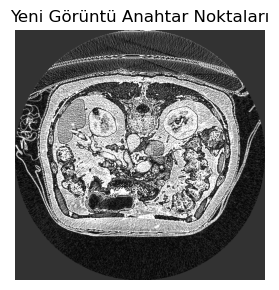

In [46]:
import cv2
import numpy as np
import pickle
import pywt
from scipy.stats import kurtosis, skew

# Kaydedilmiş verileri yükle
with open('C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_combined.pkl', 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilmiş veri setinden tanımlayıcı matrisleri ve anahtar noktaları çıkar
all_descriptors = []
keypoints_store = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp in keypoints_list:
        all_descriptors.append(kp['descriptor'])
        keypoints_store.append((kp['pt'][0], kp['pt'][1]))

# Özellik matrislerini birleştirmek ve normalize etmek
max_descriptor_length = max(len(descriptor) for descriptor in all_descriptors)
all_descriptors_uniform = [
    np.pad(descriptor, (0, max_descriptor_length - len(descriptor)), 'constant', constant_values=0)
    if len(descriptor) < max_descriptor_length else descriptor
    for descriptor in all_descriptors
]
all_descriptors_uniform = np.vstack(all_descriptors_uniform)

# FLANN eşleştirici ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=200)
search_params = dict(checks=500)

flann = cv2.FlannBasedMatcher(index_params, search_params)

# Yeni görüntü yükle ve anahtar noktaları çıkar
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto5.png'
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
sift = cv2.SIFT_create()
new_keypoints, new_descriptors = sift.detectAndCompute(new_image, None)

# Yeni görüntü için Wavelet özelliklerini çıkar
def extract_wavelet_features(patch, wavelet='db4', level=2):
    coeffs = pywt.wavedec2(patch, wavelet, level=level)
    wavelet_features = []
    for level in coeffs:
        if isinstance(level, tuple):  # Detay katsayıları
            for detail in level:
                wavelet_features.extend([
                    np.mean(detail), np.std(detail),
                    skew(detail.flatten()), kurtosis(detail.flatten())
                ])
        else:  # Yaklaşım katsayıları
            wavelet_features.extend([
                np.mean(level), np.std(level),
                skew(level.flatten()), kurtosis(level.flatten())
            ])
    return np.array(wavelet_features)

new_combined_features = []
for idx, kp in enumerate(new_keypoints):  # Tanımlayıcıya erişmek için indeks kullan
    x, y = int(kp.pt[0]), int(kp.pt[1])
    patch_size = max(min(int(kp.size * 1.5), 32), 2)  # Yama boyutunu belirle
    x_start = max(x - patch_size // 2, 0)
    x_end = min(x + patch_size // 2, new_image.shape[1])
    y_start = max(y - patch_size // 2, 0)
    y_end = min(y + patch_size // 2, new_image.shape[0])
    patch = new_image[y_start:y_end, x_start:x_end]
    if patch.shape[0] >= 8 and patch.shape[1] >= 8:
        wavelet_features = extract_wavelet_features(patch, wavelet='db4', level=2)
        combined_features = np.hstack((new_descriptors[idx], wavelet_features))
        if len(combined_features) < max_descriptor_length:
            combined_features = np.pad(combined_features, (0, max_descriptor_length - len(combined_features)), 'constant', constant_values=0)
        elif len(combined_features) > max_descriptor_length:
            combined_features = combined_features[:max_descriptor_length]

    else:
        combined_features = np.zeros(max_descriptor_length)
    new_combined_features.append(combined_features)

new_combined_features = np.vstack(new_combined_features)

# Eşleştirme işlemi
matches = flann.knnMatch(new_combined_features.astype(np.float32), all_descriptors_uniform.astype(np.float32), k=2)

# Lowe's oran testi uygulama
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

# Eşleşmeleri görüntü üzerine çiz
if good_matches:
    print(f"Geçerli eşleşme sayısı: {len(good_matches)}")
    for match in good_matches:
        kp = new_keypoints[match.queryIdx]
        cv2.circle(new_image, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size), (0, 255, 0), 2)
else:
    print("Geçerli eşleşme bulunamadı.")

# Görüntüleri birleştirerek göster
import matplotlib.pyplot as plt

plt.figure(figsize=(6, 3))
plt.subplot(1,1, 1)
plt.imshow(new_image, cmap='gray')
plt.title('Yeni Görüntü Anahtar Noktaları')
plt.axis('off')

plt.tight_layout()
plt.show()


SIFT  + GMM
 SIFT ile çıkarılmış anahtar noktalar üzerinde patch alarak GMM özellikleri SIFT'e eklenmesi 

In [47]:
import cv2
import numpy as np
import os
import pickle
from sklearn.mixture import GaussianMixture

# Gaussian Mixture Model (GMM) bileşen sayısı
gmm_components = 3

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_gmm.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için bir sözlük
all_keypoints_dict = {}

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Maskeyi görüntüye uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # SIFT nesnesi oluştur ve anahtar noktaları ve tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için bir liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                # GMM için yamayı çıkar
                x, y = int(kp.pt[0]), int(kp.pt[1])
                patch_size = max(min(int(kp.size * 1.5), 32), 2)  # Minimum boyutu 2 olarak ayarla
                x_start = max(x - patch_size // 2, 0)
                x_end = min(x + patch_size // 2, region_of_interest.shape[1])
                y_start = max(y - patch_size // 2, 0)
                y_end = min(y + patch_size // 2, region_of_interest.shape[0])
                patch = region_of_interest[y_start:y_end, x_start:x_end]

                # Yamadaki piksel sayısını kontrol et
                flattened_patch = patch.flatten().reshape(-1, 1)  # Tek boyutlu hale getir
                n_samples = flattened_patch.shape[0]

                if n_samples >= 2:  # En az 2 örnek gerekiyor
                    n_components = min(gmm_components, n_samples)  # GMM bileşen sayısını ayarla
                    gmm = GaussianMixture(n_components=n_components, covariance_type='diag', random_state=42)
                    gmm.fit(flattened_patch)
                    gmm_features = np.hstack((gmm.means_.flatten(), gmm.covariances_.flatten()))
                else:
                    gmm_features = np.array([])  # Yeterli veri yoksa boş özellik ata

                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx],
                    'gmm_features': gmm_features
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgilendirme mesajı yazdır
        print(f"{file_name}: Tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"{file_name} dosyası işlenirken hata oluştu: {e}")

# Tüm anahtar noktaları bir dosyada kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: Tespit edilen anahtar nokta sayısı: 25
foto2.png: Tespit edilen anahtar nokta sayısı: 23
foto3.png: Tespit edilen anahtar nokta sayısı: 24
foto4.png: Tespit edilen anahtar nokta sayısı: 12
foto5.png: Tespit edilen anahtar nokta sayısı: 17
foto6.png: Tespit edilen anahtar nokta sayısı: 15
foto7.png: Tespit edilen anahtar nokta sayısı: 22
foto8.png: Tespit edilen anahtar nokta sayısı: 14
foto9.png: Tespit edilen anahtar nokta sayısı: 21
foto10.png: Tespit edilen anahtar nokta sayısı: 14
Tüm anahtar noktalar kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_gmm.pkl
Tüm görüntüler için işlem tamamlandı.


TRYING TO CATHCH GMM
anahtar noktaları fotoğraf üzerinde denemek  

Geçerli eşleşme sayısı: 3


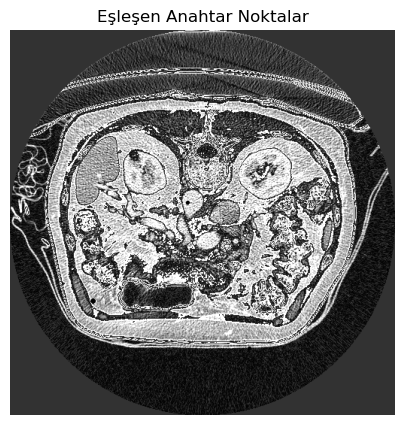

In [48]:
import cv2
import numpy as np
import pickle
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import normalize
import matplotlib.pyplot as plt

# Kaydedilmiş verileri yükleme
with open('C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_gmm.pkl', 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilmiş verilerden tanımlayıcıları ve GMM özelliklerini çıkarma
all_descriptors = []
all_gmm_features = []
keypoints_store = []

# Maksimum GMM uzunluğunu belirleme
gmm_components = 5  # GMM bileşen sayısı
max_gmm_length = gmm_components * 2  # (means + covariances)

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp in keypoints_list:
        all_descriptors.append(kp['descriptor'])
        if len(kp['gmm_features']) > 0:
            padded_gmm_features = np.pad(kp['gmm_features'], (0, max_gmm_length - len(kp['gmm_features'])), 'constant', constant_values=0)
            all_gmm_features.append(padded_gmm_features)
        else:
            all_gmm_features.append(np.zeros(max_gmm_length))  # GMM özellik boyutunu sıfırlarla doldur
        keypoints_store.append((kp['pt'][0], kp['pt'][1]))

# Tüm özellikleri normalize etme ve birleştirme
all_descriptors = np.array(all_descriptors)
all_gmm_features = np.array(all_gmm_features)
all_gmm_features_normalized = normalize(all_gmm_features, axis=1)

all_features = np.hstack((all_descriptors, all_gmm_features_normalized))

# Yeni bir görüntüden özellikleri çıkarma
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto5.png'
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError(f"Yeni görüntü yüklenemedi: {new_image_path}")

sift = cv2.SIFT_create()
new_keypoints, new_descriptors = sift.detectAndCompute(new_image, None)

if not new_keypoints:
    raise ValueError(f"Yeni görüntüde anahtar nokta bulunamadı: {new_image_path}")

# Yeni görüntü için GMM özelliklerini çıkarma
new_gmm_features = []
for kp in new_keypoints:
    x, y = int(kp.pt[0]), int(kp.pt[1])
    patch_size = max(min(int(kp.size * 1.5), 32), 2)
    x_start = max(x - patch_size // 2, 0)
    x_end = min(x + patch_size // 2, new_image.shape[1])
    y_start = max(y - patch_size // 2, 0)
    y_end = min(y + patch_size // 2, new_image.shape[0])
    patch = new_image[y_start:y_end, x_start:x_end]
    flattened_patch = patch.flatten().reshape(-1, 1)

    if len(flattened_patch) >= gmm_components:
        gmm = GaussianMixture(n_components=gmm_components, covariance_type='diag', random_state=42)
        gmm.fit(flattened_patch)
        gmm_features = np.hstack((gmm.means_.flatten(), gmm.covariances_.flatten()))
    else:
        gmm_features = np.zeros(max_gmm_length)

    new_gmm_features.append(gmm_features)

new_gmm_features = np.array(new_gmm_features)
new_gmm_features_normalized = normalize(new_gmm_features, axis=1)

# Yeni özelliklerin birleştirilmesi
new_features = np.hstack((new_descriptors, new_gmm_features_normalized))

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=200)
search_params = dict(checks=500)

flann = cv2.FlannBasedMatcher(index_params, search_params)

# FLANN ile eşleştirme
matches = flann.knnMatch(new_features.astype(np.float32), all_features.astype(np.float32), k=2)

# Lowe oran testini uygula
good_matches = []
for m, n in matches:
    if m.distance < 0.7 * n.distance:
        good_matches.append(m)

# Eşleşen anahtar noktaları görüntüde çizme
if good_matches:
    print(f"Geçerli eşleşme sayısı: {len(good_matches)}")
    for match in good_matches:
        kp = new_keypoints[match.queryIdx]
        cv2.circle(new_image, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size), (0, 255, 0), 2)
else:
    print("Geçerli eşleşme bulunamadı.")

# Görüntüyü gösterme
plt.figure(figsize=(5, 5))
plt.imshow(new_image, cmap='gray')
plt.title("Eşleşen Anahtar Noktalar")
plt.axis("off")
plt.show()


SIFT  + HOG 
 SIFT ile çıkarılmış anahtar noktalar üzerinde patch alarak HOG özellikleri SIFT'e eklenmesi 

In [49]:
import cv2
import numpy as np
import os
import pickle
from skimage.feature import hog

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_hog.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için bir sözlük
all_keypoints_dict = {}

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Maskeyi görüntüye uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # SIFT nesnesi oluştur ve anahtar noktaları ve tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için bir liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                # HOG özelliklerini çıkar
                x, y = int(kp.pt[0]), int(kp.pt[1])
                patch_size = max(min(int(kp.size * 1.5), 32), 2)  # Minimum boyutu 2 olarak ayarla
                x_start = max(x - patch_size // 2, 0)
                x_end = min(x + patch_size // 2, region_of_interest.shape[1])
                y_start = max(y - patch_size // 2, 0)
                y_end = min(y + patch_size // 2, region_of_interest.shape[0])
                patch = region_of_interest[y_start:y_end, x_start:x_end]

                # HOG çıkarımı için yamayı kontrol et
                if patch.shape[0] >= 16 and patch.shape[1] >= 16:
                    hog_features = hog(patch, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=False)
                else:
                    hog_features = np.array([])

                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx],
                    'hog_features': hog_features
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgilendirme mesajı yazdır
        print(f"{file_name}: Tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"{file_name} dosyası işlenirken hata oluştu: {e}")

# Tüm anahtar noktaları bir dosyada kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: Tespit edilen anahtar nokta sayısı: 25
foto2.png: Tespit edilen anahtar nokta sayısı: 23
foto3.png: Tespit edilen anahtar nokta sayısı: 24
foto4.png: Tespit edilen anahtar nokta sayısı: 12
foto5.png: Tespit edilen anahtar nokta sayısı: 17
foto6.png: Tespit edilen anahtar nokta sayısı: 15
foto7.png: Tespit edilen anahtar nokta sayısı: 22
foto8.png: Tespit edilen anahtar nokta sayısı: 14
foto9.png: Tespit edilen anahtar nokta sayısı: 21
foto10.png: Tespit edilen anahtar nokta sayısı: 14
Tüm anahtar noktalar kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_hog.pkl
Tüm görüntüler için işlem tamamlandı.


TRYING TO CATHCH HOG 
anahtar noktaları fotoğraf üzerinde denemek  

Geçerli eşleşme sayısı: 7


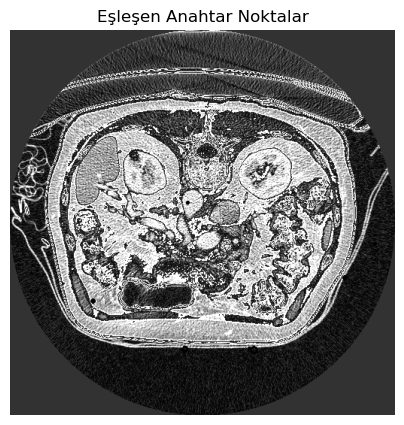

In [50]:
import cv2
import numpy as np
import pickle
from skimage.feature import hog

# Kaydedilmiş verileri yükleme
with open('C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_hog.pkl', 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilmiş verilerden tanımlayıcıları ve HOG özelliklerini çıkarma
all_descriptors = []
all_hogs = []
keypoints_store = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp in keypoints_list:
        all_descriptors.append(kp['descriptor'])
        all_hogs.append(kp['hog_features'] if len(kp['hog_features']) > 0 else np.zeros(36))
        keypoints_store.append((kp['pt'][0], kp['pt'][1]))

# HOG özellikleri için maksimum uzunluğu belirleme ve birleştirme
max_hog_length = max(len(hog) for hog in all_hogs)
all_hogs_uniform = [np.pad(hog, (0, max_hog_length - len(hog)), 'constant', constant_values=0) if len(hog) < max_hog_length else hog for hog in all_hogs]

all_descriptors = np.vstack(all_descriptors)
all_hogs_uniform = np.vstack(all_hogs_uniform)

# FLANN eşleştirme parametreleri
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=200)
search_params = dict(checks=500)

flann = cv2.FlannBasedMatcher(index_params, search_params)

# Yeni bir görüntüyü yükleme ve anahtar noktalarını çıkarma
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto5.png'
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
sift = cv2.SIFT_create()
new_keypoints, new_descriptors = sift.detectAndCompute(new_image, None)

# Yeni görüntü için HOG özelliklerini çıkarma
new_hogs = []
for kp in new_keypoints:
    x, y = int(kp.pt[0]), int(kp.pt[1])
    patch_size = max(min(int(kp.size * 1.5), 32), 2)
    x_start = max(x - patch_size // 2, 0)
    x_end = min(x + patch_size // 2, new_image.shape[1])
    y_start = max(y - patch_size // 2, 0)
    y_end = min(y + patch_size // 2, new_image.shape[0])
    patch = new_image[y_start:y_end, x_start:x_end]
    if patch.shape[0] >= 16 and patch.shape[1] >= 16:
        hog_features = hog(patch, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=False)
        hog_features = np.pad(hog_features, (0, max_hog_length - len(hog_features)), 'constant', constant_values=0)
    else:
        hog_features = np.zeros(max_hog_length)
    new_hogs.append(hog_features)

new_descriptors = np.array(new_descriptors)
new_hogs = np.vstack(new_hogs)
new_features = np.hstack((new_descriptors, new_hogs))

# Eşleştirme FLANN ile yapılır ve en yakın komşular kontrol edilir
matches = flann.knnMatch(new_features.astype(np.float32), np.hstack((all_descriptors, all_hogs_uniform)).astype(np.float32), k=2)

# Lowe'un oran testini uygula
good_matches = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches.append(m)

# Eşleşen anahtar noktaları görüntüde çizme
if good_matches:
    print(f"Geçerli eşleşme sayısı: {len(good_matches)}")
    for match in good_matches:
        kp = new_keypoints[match.queryIdx]
        cv2.circle(new_image, (int(kp.pt[0]), int(kp.pt[1])), int(kp.size), (0, 255, 0), 2)
else:
    print("Geçerli eşleşme bulunamadı.")

# Görüntüyü gösterme
import matplotlib.pyplot as plt

plt.figure(figsize=(5, 5))
plt.imshow(new_image, cmap='gray')
plt.title("Eşleşen Anahtar Noktalar")
plt.axis("off")
plt.show()


TRYING TO CATCH USING KNN DEMO 
farklı yöntemler deneyip anahtar noktaları denemek 

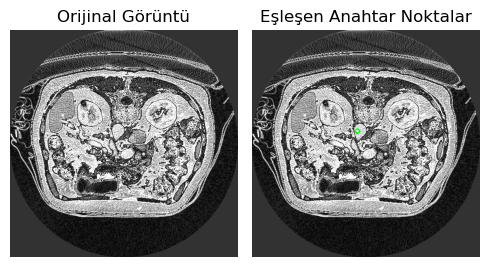

Eşleşen anahtar noktaların sayısı: 1


In [51]:
import cv2
import numpy as np
import os
import pickle
from skimage.feature import hog
from sklearn.neighbors import NearestNeighbors

# Kaydedilmiş verileri yükleme
with open('C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_hog.pkl', 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilmiş verilerden SIFT tanımlayıcıları ve HOG özelliklerini çıkarma
all_descriptors = []
all_hogs = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp in keypoints_list:
        all_descriptors.append(kp['descriptor'])
        all_hogs.append(kp['hog_features'] if len(kp['hog_features']) > 0 else np.zeros(36))

# HOG özellikleri için maksimum uzunluğu belirleme
max_hog_length = max(len(hog) for hog in all_hogs)

# Tüm HOG özelliklerini aynı boyuta getirme
all_hogs_uniform = []
for hog_features in all_hogs:
    if len(hog_features) < max_hog_length:
        # Boyutu eşitlemek için sıfırlar ekleme
        padded_hog = np.pad(hog_features, (0, max_hog_length - len(hog_features)), 'constant', constant_values=0)
        all_hogs_uniform.append(padded_hog)
    else:
        all_hogs_uniform.append(hog_features)

all_descriptors = np.vstack(all_descriptors)
all_hogs_uniform = np.vstack(all_hogs_uniform)

# Yeni bir görüntüyü yükleme ve anahtar noktalarını ve özelliklerini çıkarma
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto5.png'
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
sift = cv2.SIFT_create()
new_keypoints, new_descriptors = sift.detectAndCompute(new_image, None)

new_hogs = []
for kp in new_keypoints:
    x, y = int(kp.pt[0]), int(kp.pt[1])
    patch_size = max(min(int(kp.size * 1.5), 32), 2)
    x_start = max(x - patch_size // 2, 0)
    x_end = min(x + patch_size // 2, new_image.shape[1])
    y_start = max(y - patch_size // 2, 0)
    y_end = min(y + patch_size // 2, new_image.shape[0])
    patch = new_image[y_start:y_end, x_start:x_end]
    if patch.shape[0] >= 16 and patch.shape[1] >= 16:
        hog_features = hog(patch, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=False)
        if len(hog_features) < max_hog_length:
            hog_features = np.pad(hog_features, (0, max_hog_length - len(hog_features)), 'constant', constant_values=0)
        new_hogs.append(hog_features)
    else:
        new_hogs.append(np.zeros(max_hog_length))

new_descriptors = np.array(new_descriptors)
new_hogs = np.vstack(new_hogs)

# k-NN ile SIFT tanımlayıcıları ve HOG özelliklerini eşleştirme
knn_desc = NearestNeighbors(n_neighbors=1).fit(all_descriptors)
knn_hog = NearestNeighbors(n_neighbors=1).fit(all_hogs_uniform)

distances_desc, indices_desc = knn_desc.kneighbors(new_descriptors)
distances_hog, indices_hog = knn_hog.kneighbors(new_hogs)

# Eşik değeri belirleme
some_threshold = 110.0  # Bu değeri deneyerek optimize edebilirsiniz

# En iyi eşleşmeleri bulma
best_matches = []
for i in range(len(new_keypoints)):
    if distances_desc[i][0] + distances_hog[i][0] < some_threshold:
        best_matches.append((i, indices_desc[i][0]))

# Görüntü üzerinde eşleşen anahtar noktaları çizme
matched_image = cv2.cvtColor(new_image, cv2.COLOR_GRAY2BGR)
for match in best_matches:
    kp = new_keypoints[match[0]]
    cv2.circle(matched_image, (int(kp.pt[0]), int(kp.pt[1])), 5, (0, 255, 0), 2)

# Görüntüleri gösterme
import matplotlib.pyplot as plt

plt.figure(figsize=(5, 5))
plt.subplot(1, 2, 1)
plt.imshow(new_image, cmap='gray')
plt.title("Orijinal Görüntü")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(matched_image[..., ::-1])
plt.title("Eşleşen Anahtar Noktalar")
plt.axis("off")

plt.tight_layout()
plt.show()

# Eşleşme sayısını yazdırma
print(f"Eşleşen anahtar noktaların sayısı: {len(best_matches)}")


SIFT + GLCM SAVING KEY POINTS (Gray-Level Co-Occurrence Matrix)
 SIFT ile çıkarılmış anahtar noktalar üzerinde patch alarak GLCM özellikleri SIFT'e eklenmesi 

bu yöntem denediğimiz en iyi yöntemdir , çünkü asıl ulaşmak istediğmiz hedefimize çok faydalı , anahtar noktaları çok zengin ve herhangi bir fotoğrafta ventrikülü yakalayabilir , birkaç tane aykırı noktalar çıkar

entropy,dissimilarity,correlation,energy,homogeneity,contrast
bu özelliklerin hepsinin eklenmesi ,anahtar noktaların kalitesini çok artırdı 

In [52]:
import cv2
import numpy as np
import os
import pickle
from skimage.feature import graycomatrix, graycoprops

# Dosyaların yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_glcm.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktaları ve özelliklerini saklamak için bir sözlük
all_keypoints_dict = {}

# Kaydetme işlemi
for file_name in file_names:
    try:
        # Görüntü ve maske yükleme
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Maskeyi görüntüye uygulama
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # SIFT nesnesi oluşturma ve anahtar noktaları ile tanımlayıcıları çıkarma
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve GLCM özelliklerini saklamak için liste
        keypoints_list = []
        avoided_keypoints_count = 0
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                # GLCM özelliklerini çıkarma
                patch_size = max(min(int(kp.size * 1.5), 32), 2)
                x, y = int(kp.pt[0]), int(kp.pt[1])
                x_start = max(x - patch_size // 2, 0)
                x_end = min(x + patch_size // 2, region_of_interest.shape[1])
                y_start = max(y - patch_size // 2, 0)
                y_end = min(y + patch_size // 2, region_of_interest.shape[0])

                patch = region_of_interest[y_start:y_end, x_start:x_end]

                # Özelliklerin çıkarılması için yama boyutunun yeterli olup olmadığını kontrol etme
                if patch.shape[0] < 2 or patch.shape[1] < 2:
                    avoided_keypoints_count += 1
                    continue

                glcm = graycomatrix(
                    patch,
                    distances=[1, 2],
                    angles=[0, np.pi / 4, np.pi / 2, 3 * np.pi / 4],
                    levels=256,
                    symmetric=True,
                    normed=True
                )
                contrast = np.mean(graycoprops(glcm, 'contrast'))
                homogeneity = np.mean(graycoprops(glcm, 'homogeneity'))
                energy = np.mean(graycoprops(glcm, 'energy'))
                correlation = np.mean(graycoprops(glcm, 'correlation'))
                dissimilarity = np.mean(graycoprops(glcm, 'dissimilarity'))
                entropy = -np.sum(glcm * np.log(glcm + 1e-10))  # log(0) durumunu önlemek için
                glcm_features = [contrast, homogeneity, energy, correlation, dissimilarity, entropy]

                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx],
                    'glcm_features': glcm_features
                }
                keypoints_list.append(kp_dict)

        all_keypoints_dict[file_name] = keypoints_list
        print(f"{file_name}: {len(keypoints_list)} anahtar noktalar kaydedildi, {avoided_keypoints_count} anahtar noktalar atlandı.")

    except Exception as e:
        print(f"{file_name} işlenirken hata oluştu: {e}")

# Anahtar noktaları dosyaya kaydetme
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar {output_file} dosyasına kaydedildi.")


foto1.png: 25 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
foto2.png: 23 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
foto3.png: 24 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
foto4.png: 12 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
foto5.png: 17 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
foto6.png: 15 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
foto7.png: 22 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
foto8.png: 14 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
foto9.png: 21 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
foto10.png: 14 anahtar noktalar kaydedildi, 0 anahtar noktalar atlandı.
Tüm anahtar noktalar C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_glcm.pkl dosyasına kaydedildi.


TRYING TO CATCH GLCM 
anahatar noktaları datasetin fotoğrafların dışında başka fotoğraf üzerinde denemsi 
 

Geçerli iyi eşleşme sayısı: 1


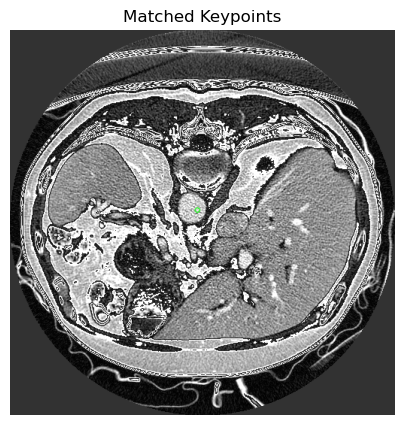

In [53]:
import cv2
import pickle
import numpy as np
from skimage.feature import graycomatrix, graycoprops
from sklearn.preprocessing import StandardScaler

# Kaydedilmiş anahtar noktaları yükleme
with open('C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints_glcm.pkl', 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm dosyalardan anahtar noktaları toplama
all_keypoints = []
all_descriptors = []
for keypoints_list in all_keypoints_dict.values():
    for kp_dict in keypoints_list:
        all_keypoints.append(cv2.KeyPoint(kp_dict['pt'][0], kp_dict['pt'][1], kp_dict['size'], kp_dict['angle'], kp_dict['response'], kp_dict['octave'], kp_dict['class_id']))
        all_descriptors.append(np.hstack((kp_dict['descriptor'], kp_dict['glcm_features'])).astype(np.float32))

all_descriptors = np.array(all_descriptors)
scaler_saved = StandardScaler()
all_descriptors = scaler_saved.fit_transform(all_descriptors).astype(np.float32)

# Yeni görüntü hazırlama
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto1.png'
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı.")

# SIFT başlatma
sift = cv2.SIFT_create()
keypoints_new, descriptors_new = sift.detectAndCompute(new_image, None)

# Yeni görüntüdeki anahtar noktalar için GLCM özelliklerini çıkarma
glcm_features_new = []
for kp in keypoints_new:
    x, y = int(kp.pt[0]), int(kp.pt[1])
    patch_size = max(min(int(kp.size * 1.5), 32), 2)  # Yama boyutunu kontrol etme
    x_start = max(x - patch_size // 2, 0)
    x_end = min(x + patch_size // 2, new_image.shape[1])
    y_start = max(y - patch_size // 2, 0)
    y_end = min(y + patch_size // 2, new_image.shape[0])
    patch = new_image[y_start:y_end, x_start:x_end]
    if patch.size > 0:  # Yamanın içerik içerdiğinden emin olma
        glcm = graycomatrix(patch, distances=[1, 2], angles=[0, np.pi / 4, np.pi / 2, 3 * np.pi / 4], levels=256, symmetric=True, normed=True)
        contrast = np.mean(graycoprops(glcm, 'contrast'))
        homogeneity = np.mean(graycoprops(glcm, 'homogeneity'))
        energy = np.mean(graycoprops(glcm, 'energy'))
        correlation = np.mean(graycoprops(glcm, 'correlation'))
        dissimilarity = np.mean(graycoprops(glcm, 'dissimilarity'))
        entropy = -np.sum(glcm * np.log(glcm + 1e-10))  # log(0) durumunu önlemek için
        glcm_features_new.append([contrast, homogeneity, energy, correlation, dissimilarity, entropy])

# Özellikleri normalleştirme
scaler = StandardScaler()
descriptors_new = scaler.fit_transform(descriptors_new).astype(np.float32)
if glcm_features_new:
    glcm_features_new = np.array(glcm_features_new)
    scaler_glcm = StandardScaler()
    glcm_features_new = scaler_glcm.fit_transform(glcm_features_new).astype(np.float32)  # Yeni GLCM özelliklerini normalleştirme

# SIFT ve GLCM özelliklerini birleştirme
if glcm_features_new.size > 0:
    combined_features_new = np.hstack((descriptors_new, glcm_features_new))
else:
    combined_features_new = descriptors_new  # Eğer GLCM özellikleri yoksa sadece SIFT özelliklerini kullan

# Özellikleri eşleştirme
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=200)
search_params = dict(checks=500)
flann = cv2.FlannBasedMatcher(index_params, search_params)
matches = flann.knnMatch(all_descriptors, combined_features_new, k=2)

# Lowe oran testi uygulayarak iyi eşleşmeleri bulma
good_matches = []
for m, n in matches:
    if m.distance < 0.8 * n.distance:
        good_matches.append(m)

# Geçerli iyi eşleşmeleri kontrol etme ve geçersizleri dışlama
valid_good_matches = [m for m in good_matches if 0 <= m.queryIdx < len(all_keypoints) and 0 <= m.trainIdx < len(keypoints_new)]

# Yeni görüntü üzerinde geçerli noktaları çizme
if valid_good_matches:
    print(f"Geçerli iyi eşleşme sayısı: {len(valid_good_matches)}")
    
    # Geçerli anahtar noktaları çizme
    keypoints_draw = [keypoints_new[m.trainIdx] for m in valid_good_matches]
    matched_image = cv2.drawKeypoints(new_image, keypoints_draw, None, color=(0, 255, 0))
    
    # Görüntüyü gösterme
    plt.figure(figsize=(5, 5))
    plt.title("Matched Keypoints")
    plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))  
    plt.axis('off')
    plt.show()

else:
    print("Geçerli eşleşme bulunamadı.")


SİFT+GLCM+HOG 

In [67]:
import cv2
import numpy as np
import os
import pickle
import mahotas
from skimage import img_as_ubyte

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoint_glcm_hog.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png', 'foto2.png', 'foto3.png', 'foto4.png', 'foto5.png',
    'foto6.png', 'foto7.png', 'foto8.png', 'foto9.png', 'foto10.png'
]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

def compute_hog(image):
    """HOG (Histogram of Oriented Gradients) özelliklerini hesaplar."""
    win_size = (32, 32)  # Daha büyük pencere boyutu
    block_size = (16, 16)
    block_stride = (8, 8)
    cell_size = (8, 8)
    nbins = 18  # Daha fazla yön sayısı
    hog = cv2.HOGDescriptor(win_size, block_size, block_stride, cell_size, nbins)
    h = hog.compute(image)
    return h.flatten()

def compute_glcm_features(image):
    """GLCM (Gray Level Co-occurrence Matrix) özelliklerini hesaplar."""
    glcm = mahotas.features.haralick(image)
    # Tüm yönler için özellikler alınır
    features = {
        'contrast': glcm[:, 0].mean(),
        'dissimilarity': glcm[:, 1].mean(),
        'homogeneity': glcm[:, 2].mean(),
        'energy': glcm[:, 4].mean(),
        'correlation': glcm[:, 6].mean(),
        'contrast_0': glcm[:, 0].mean(),  # 0°
        'contrast_45': glcm[:, 1].mean(),  # 45°
        'contrast_90': glcm[:, 2].mean(),  # 90°
        'contrast_135': glcm[:, 3].mean()  # 135°
    }
    return features

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        
        # Görüntüleri gri tonlamada oku
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru bir şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Maskeyi biraz yumuşatarak kenarları daha düzgün hale getirebiliriz
        mask_image = cv2.GaussianBlur(mask_image, (5, 5), 0)

        # Maskeyi görüntüye uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # SIFT nesnesi oluştur
        sift = cv2.SIFT_create()

        # Anahtar noktaları ve tanımlayıcıları çıkar
        keypoints, descriptors = sift.detectAndCompute(region_of_interest, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                # Anahtar noktanın bulunduğu bölgede HOG ve GLCM özelliklerini hesapla
                x, y = int(kp.pt[0]), int(kp.pt[1])
                size = int(kp.size // 2)

                # Patch boyutlarına margin eklemek
                patch_margin = 10  # Daha geniş bir margin
                patch = region_of_interest[max(0, y-size-patch_margin):y+size+patch_margin, max(0, x-size-patch_margin):x+size+patch_margin]

                # Patch boyutunun kenarlarda kaymalar olmasını engellemek için sıfır ekliyoruz
                patch_height, patch_width = patch.shape
                if patch_height > 0 and patch_width > 0:
                    patch_resized = cv2.resize(patch, (128, 128), interpolation=cv2.INTER_CUBIC)  # HOG için yeniden boyutlandır
                    hog_features = compute_hog(patch_resized)

                    # GLCM özelliklerini hesapla
                    glcm_features = compute_glcm_features(img_as_ubyte(patch_resized))

                    # Her anahtar nokta için veriyi sakla
                    kp_dict = {
                        'pt': kp.pt,
                        'size': kp.size,
                        'angle': kp.angle,
                        'response': kp.response,
                        'octave': kp.octave,
                        'class_id': kp.class_id,
                        'descriptor': descriptors[idx].tolist(),  # NumPy dizisini listeye dönüştür
                        'hog_features': hog_features.tolist(),   # HOG özelliklerini listeye dönüştür
                        'glcm_features': glcm_features
                    }
                    keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgi yazdır
        print(f"{file_name}: SIFT ile tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"Hata oluştu: {file_name}: {e}")

# Tüm anahtar noktaları tek bir dosyaya kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar şu dosyaya kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: SIFT ile tespit edilen anahtar nokta sayısı: 15
foto2.png: SIFT ile tespit edilen anahtar nokta sayısı: 18
foto3.png: SIFT ile tespit edilen anahtar nokta sayısı: 22
foto4.png: SIFT ile tespit edilen anahtar nokta sayısı: 14
foto5.png: SIFT ile tespit edilen anahtar nokta sayısı: 10
foto6.png: SIFT ile tespit edilen anahtar nokta sayısı: 16
foto7.png: SIFT ile tespit edilen anahtar nokta sayısı: 17
foto8.png: SIFT ile tespit edilen anahtar nokta sayısı: 18
foto9.png: SIFT ile tespit edilen anahtar nokta sayısı: 16
foto10.png: SIFT ile tespit edilen anahtar nokta sayısı: 16
Tüm anahtar noktalar şu dosyaya kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoint_glcm_hog.pkl
Tüm görüntüler için işlem tamamlandı.


In [ ]:
SIFT+HOG+GLCM KULLANARAK KAYDETTİĞİMİZ NOKTALARI YENİ GÖRÜNTÜ VEREREK TEST ETTİM.

Kaydedilen toplam anahtar nokta sayısı: 162
Yeni görüntüdeki anahtar nokta sayısı: 2958
İyi eşleşme sayısı: 7


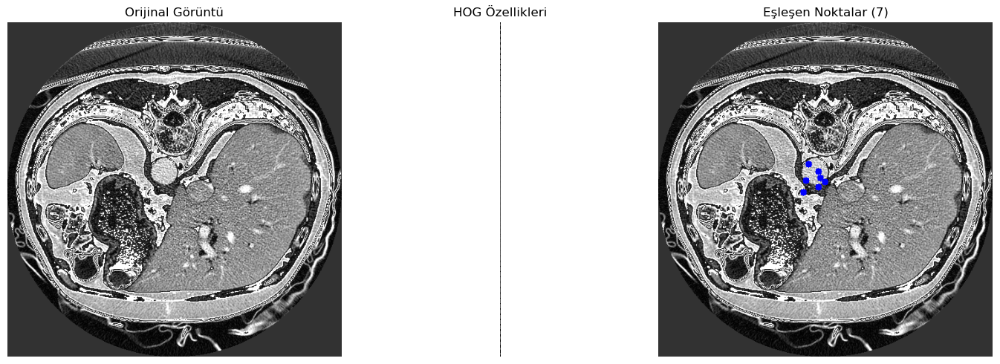

In [68]:
import cv2
import pickle
import numpy as np
import mahotas
import matplotlib.pyplot as plt

# HOG hesaplama fonksiyonu
def compute_hog(image):
    win_size = (16, 16)
    block_size = (8, 8)
    block_stride = (4, 4)
    cell_size = (8, 8)
    nbins = 9
    hog = cv2.HOGDescriptor(win_size, block_size, block_stride, cell_size, nbins)
    h = hog.compute(image)
    return h.flatten()

# GLCM hesaplama fonksiyonu
def compute_glcm_features(image):
    image = np.uint8(image)  # GLCM hesaplaması için görüntüyü uint8'e dönüştür
    glcm = mahotas.features.haralick(image)
    features = {
        'contrast': glcm[:, 0].mean(),
        'dissimilarity': glcm[:, 1].mean(),
        'homogeneity': glcm[:, 2].mean(),
        'energy': glcm[:, 4].mean(),
        'correlation': glcm[:, 6].mean()
    }
    return np.array(list(features.values()))  # Bir dizi olarak döndür

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoint_glcm_hog.pkl'

# Kaydedilen verileri oku
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm kaydedilen anahtar noktaları ve tanımlayıcıları birleştir
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Tanımlayıcıları NumPy dizisine dönüştür
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni görüntünün yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_68.png'

# Yeni görüntüyü yükle
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı, dosya yolunu kontrol edin.")

# SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Yeni görüntüden anahtar noktaları ve tanımlayıcıları çıkar
keypoints_new, descriptors_new = sift.detectAndCompute(new_image, None)

print(f"Yeni görüntüdeki anahtar nokta sayısı: {len(keypoints_new)}")

# HOG ve GLCM özelliklerini çıkar
hog_new = compute_hog(new_image)
glcm_new = compute_glcm_features(new_image)

# FLANN ile anahtar nokta eşleştirme
# FLANN parametrelerini ayarlama
index_params = dict(algorithm=1, trees=50)  # Ağaç sayısını artır
search_params = dict(checks=80)  # Kontrol sayısını artır
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Tanımlayıcıları FLANN ile eşleştir
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe's Ratio Test parametresini daha katı yapalım
good_matches = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:  # Eşleşme oranını biraz daha katı hale getir
        good_matches.append(m)
print(f"İyi eşleşme sayısı: {len(good_matches)}")

# Yeni görüntüde eşleşen noktaları çiz
matched_image = cv2.cvtColor(new_image, cv2.COLOR_GRAY2BGR)

# Çizgilerin görünürlüğünü artırmak için noktalara farklı renklerde daireler ekleyelim
for match in good_matches:
    img1_idx = match.queryIdx
    img2_idx = match.trainIdx
    (x1, y1) = keypoints_saved[img1_idx].pt
    (x2, y2) = keypoints_new[img2_idx].pt
    
    # Eşleşen noktaları daire ile işaretleyelim
    cv2.circle(matched_image, (int(x1), int(y1)), 5, (255, 0, 0), -1)  # Mavi daire


# Görselleri yan yana göster
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Orijinal görüntü
axs[0].imshow(new_image, cmap='gray')
axs[0].set_title("Orijinal Görüntü")
axs[0].axis('off')

# HOG ile işlenmiş görüntü (örnek olarak)
axs[1].imshow(hog_new.reshape(-1, 1), cmap='gray')  # HOG görüntüsünün sadece örnek olarak bir sütununu göster
axs[1].set_title("HOG Özellikleri")
axs[1].axis('off')

# Eşleşen anahtar noktalar
if len(good_matches) > 0:
    axs[2].imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
    axs[2].set_title(f"Eşleşen Noktalar ({len(good_matches)})")
else:
    axs[2].imshow(new_image, cmap='gray')
    axs[2].set_title("Eşleşme Bulunamadı")
axs[2].axis('off')

plt.tight_layout()
plt.show()


NOT: Harris, ORB, SURF ve AKAZE gibi diğer teknikler yerine SIFT kullandım çünkü projede zaman faktörü çok önemli değil ve doğruluk bizim için öncelikli. Deneyip araştırdıktan sonra, SIFT'in bizim ihtiyaçlarımız için en uygun teknik olduğunu gördük. SIFT, ölçek ve dönüşüm değişikliklerine karşı dayanıklı olması ve yüksek doğruluk sağlamasıyla öne çıkıyor.
Anahtar noktaların özellikleri zenginliği artırmak için şu teknikleri denedik : LBP, GABOR, WAVELET DÖNÜŞÜMÜ, GMM, HOG, GLCM.

şu anda SIFT + LBP yöntemine geri döneceğiz, çünkü bu yöntem, önceden tanımlanmış anahtar noktalara sahip görüntülerde en iyi sonuçları sağlıyor.

 SIFT USING LBP 
 fotğrafların anahtar noktaları çıkarmak ama LBP (local binary pattern) uyguladıktan sonra , burada bütün fotoğrafa LBP uyguluyoruz sonra anahtar noktarları çıkarıyoruz

In [54]:
import cv2
import numpy as np
import os
import pickle
from skimage.feature import local_binary_pattern

# LBP ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Dosya yolları
xray_images_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/'  # Röntgen görüntüleri klasörü
masks_folder = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/'         # Maskeler klasörü
output_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Tüm anahtar noktaların kaydedileceği dosya

# Dosya adları listesi (görüntü ve maske dosya adları aynı olmalıdır)
file_names = [
    'foto1.png',
    'foto2.png',
    'foto3.png',
    'foto4.png',
    'foto5.png',
    'foto6.png',
    'foto7.png',
    'foto8.png',
    'foto9.png',
    'foto10.png'
    
]

# Tüm anahtar noktaları ve tanımlayıcıları saklamak için sözlük
all_keypoints_dict = {}

for file_name in file_names:
    try:
        # Görüntü ve maskeyi yükle
        xray_image_path = os.path.join(xray_images_folder, file_name)
        mask_image_path = os.path.join(masks_folder, file_name)
        xray_image = cv2.imread(xray_image_path, cv2.IMREAD_GRAYSCALE)
        mask_image = cv2.imread(mask_image_path, cv2.IMREAD_GRAYSCALE)

        # Görüntü ve maskenin doğru bir şekilde yüklendiğini doğrula
        if xray_image is None or mask_image is None:
            raise ValueError(f"Görüntü veya maske bulunamadı: {file_name}")

        # Maskeyi görüntüye uygula
        region_of_interest = cv2.bitwise_and(xray_image, xray_image, mask=mask_image)

        # İlgi bölgesine LBP uygula
        lbp = local_binary_pattern(region_of_interest, n_points, radius, METHOD)

        # LBP sonucunu normalize et
        lbp_normalized = cv2.normalize(lbp, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

        # SIFT nesnesi oluştur ve LBP üzerinden anahtar noktaları ile tanımlayıcıları çıkar
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(lbp_normalized, None)

        # Anahtar noktaları ve tanımlayıcıları saklamak için liste
        keypoints_list = []
        if descriptors is not None:
            for idx, kp in enumerate(keypoints):
                kp_dict = {
                    'pt': kp.pt,
                    'size': kp.size,
                    'angle': kp.angle,
                    'response': kp.response,
                    'octave': kp.octave,
                    'class_id': kp.class_id,
                    'descriptor': descriptors[idx]
                }
                keypoints_list.append(kp_dict)

        # Anahtar noktaları ve tanımlayıcıları ana sözlüğe ekle
        all_keypoints_dict[file_name] = keypoints_list

        # Bilgi yazdır
        print(f"{file_name}: LBP ile tespit edilen anahtar nokta sayısı: {len(keypoints_list)}")

    except Exception as e:
        print(f"Hata oluştu: {file_name}: {e}")

# Tüm anahtar noktaları tek bir dosyaya kaydet
with open(output_file, 'wb') as f:
    pickle.dump(all_keypoints_dict, f)

print(f"Tüm anahtar noktalar şu dosyaya kaydedildi: {output_file}")
print("Tüm görüntüler için işlem tamamlandı.")


foto1.png: LBP ile tespit edilen anahtar nokta sayısı: 32
foto2.png: LBP ile tespit edilen anahtar nokta sayısı: 41
foto3.png: LBP ile tespit edilen anahtar nokta sayısı: 32
foto4.png: LBP ile tespit edilen anahtar nokta sayısı: 20
foto5.png: LBP ile tespit edilen anahtar nokta sayısı: 15
foto6.png: LBP ile tespit edilen anahtar nokta sayısı: 14
foto7.png: LBP ile tespit edilen anahtar nokta sayısı: 19
foto8.png: LBP ile tespit edilen anahtar nokta sayısı: 17
foto9.png: LBP ile tespit edilen anahtar nokta sayısı: 13
foto10.png: LBP ile tespit edilen anahtar nokta sayısı: 14
Tüm anahtar noktalar şu dosyaya kaydedildi: C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl
Tüm görüntüler için işlem tamamlandı.


TRYING TO CATCH 
anahtar noktaları yakalamak 

Kaydedilen toplam anahtar nokta sayısı: 217
Yeni görüntüdeki anahtar nokta sayısı (LBP sonrası): 5662
İyi eşleşme sayısı: 15


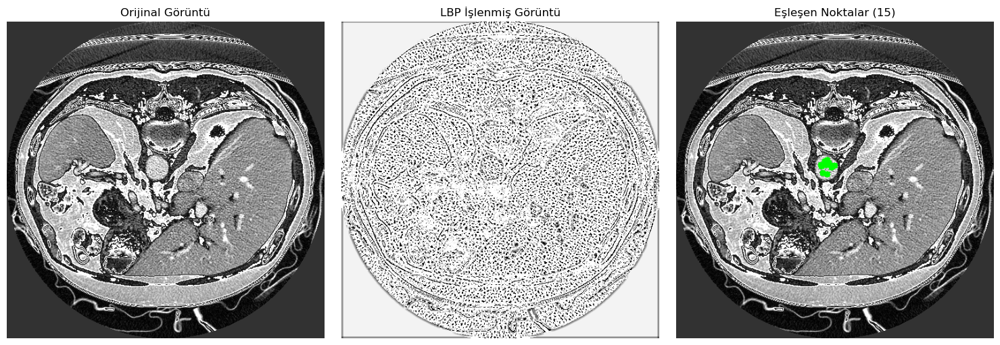

In [55]:
import cv2
import pickle
import numpy as np
import os
from skimage.feature import local_binary_pattern
import matplotlib.pyplot as plt

# LBP ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl' # Gerekirse bu yolu değiştirin

# Kaydedilen verileri oku
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm kaydedilen anahtar noktaları ve tanımlayıcıları birleştir
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Tanımlayıcıları NumPy dizisine dönüştür
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni görüntünün yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto1.png'  # Yeni görüntünün yolunu düzenleyin

# Yeni görüntüyü yükle
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni görüntü bulunamadı, dosya yolunu kontrol edin.")

# Yeni görüntüye LBP uygula
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunu normalize et
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluştur
sift = cv2.SIFT_create()

# Yeni LBP görüntüsünden anahtar noktaları ve tanımlayıcıları çıkar
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni görüntüdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# Tanımlayıcıların boş olmadığını doğrula
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Tanımlayıcılar boş. Görüntüleri ve anahtar noktaları kontrol edin.")

# FLANN matcher hazırlayın
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN kullanarak tanımlayıcıları eşleştir
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe's ratio testi uygulayarak iyi eşleşmeleri al
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşme sayısı: {len(good_matches)}")

# Yeni görüntüde eşleşen noktaları çiz
if len(good_matches) > 0:
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]
    matched_image = cv2.cvtColor(new_image, cv2.COLOR_GRAY2BGR)
    for pt in points_new:
        cv2.circle(matched_image, (int(pt[0]), int(pt[1])), 5, (0, 255, 0), -1)

# Görselleri yan yana göster
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Orijinal görüntü
axs[0].imshow(new_image, cmap='gray')
axs[0].set_title("Orijinal Görüntü")
axs[0].axis('off')

# LBP ile işlenmiş görüntü
axs[1].imshow(lbp_normalized, cmap='gray')
axs[1].set_title("LBP İşlenmiş Görüntü")
axs[1].axis('off')

# Eşleşen anahtar noktalar
if len(good_matches) > 0:
    axs[2].imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
    axs[2].set_title(f"Eşleşen Noktalar ({len(good_matches)})")
else:
    axs[2].imshow(new_image, cmap='gray')
    axs[2].set_title("Eşleşme Bulunamadı")
axs[2].axis('off')

plt.tight_layout()
plt.show()


BINARY MASK 
yakalan noktaları bainary'ye dönüştürmek 

İyi eşleşmelerin sayısı: 15


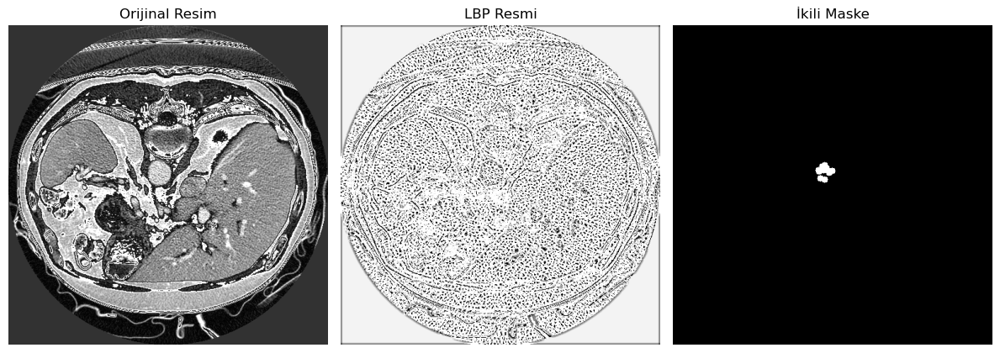

In [56]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

# Yeni resmin yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotos/foto1.png'

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

# Betimleyicilerin mevcut olduğundan emin olma
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Betimleyiciler boş.")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Betimleyicilerin eşleştirilmesi
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulaması
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# Eşleşen noktalara dayalı ikili maske oluşturma
mask = np.zeros_like(new_image, dtype=np.uint8)

if len(good_matches) > 0:
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]

    for pt in points_new:
        x, y = int(pt[0]), int(pt[1])
        # Maskeye noktaları ekleme
        cv2.circle(mask, (x, y), radius=5, color=255, thickness=-1)  # Her nokta için küçük daire

    # Maskeyi gösterme
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 3, 1)
    plt.title("Orijinal Resim")
    plt.imshow(new_image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title("LBP Resmi")
    plt.imshow(lbp_normalized, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title("İkili Maske")
    plt.imshow(mask, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


İyi eşleşmelerin sayısı: 15


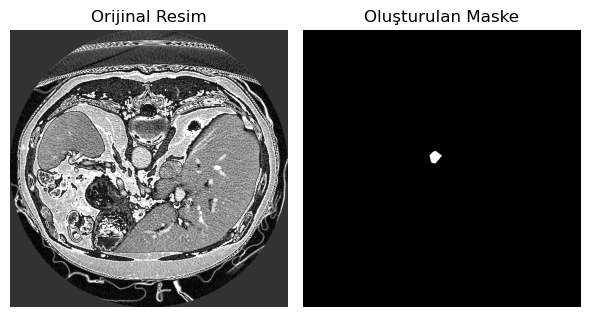

In [57]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

# Yeni resmin yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto1.png'

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

# Betimleyicilerin mevcut olduğundan emin olma
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Betimleyiciler boş.")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Betimleyicilerin eşleştirilmesi
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulaması
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# Eşleşen noktalara dayalı ikili maske oluşturma
mask = np.zeros_like(new_image, dtype=np.uint8)

if len(good_matches) > 0:
    points_new = [keypoints_new[m.trainIdx].pt for m in good_matches]

    # Noktaları tam koordinatlara dönüştürme
    points_array = np.array(points_new, dtype=np.int32)

    # Noktaları kullanarak bir çokgen oluşturma
    hull = cv2.convexHull(points_array)

    # Maskede çokgen içindeki alanı doldurma
    cv2.fillConvexPoly(mask, hull, 255)

    # Maskeyi gösterme
    plt.figure(figsize=(6, 6))
    plt.subplot(1, 2, 1)
    plt.title("Orijinal Resim")
    plt.imshow(new_image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title("Oluşturulan Maske")
    plt.imshow(mask, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


maskeyi Delaunay Triangulation (Delaunay Üçgenleştirmesi) yöntemi kullanarak çizmek 

Kaydedilen toplam anahtar nokta sayısı: 217
Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 5662
İyi eşleşmelerin sayısı: 15


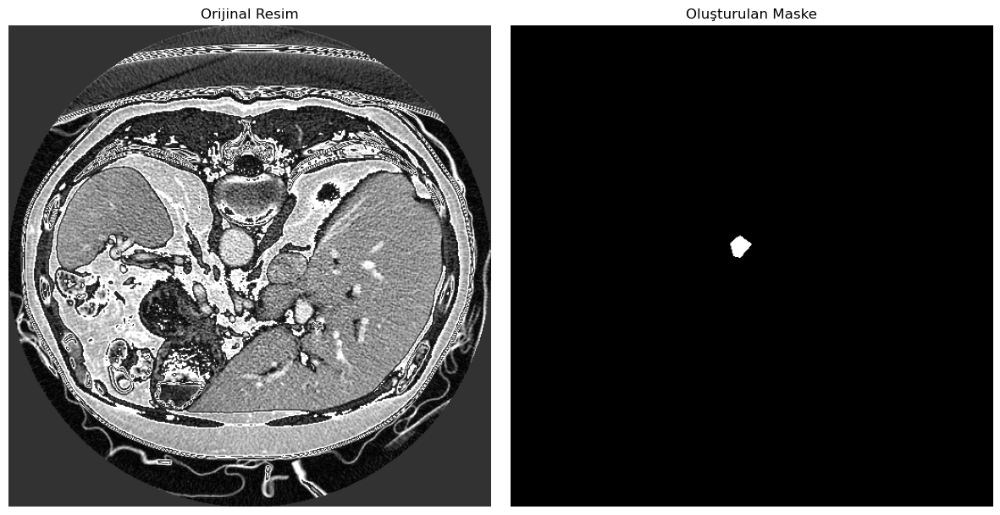

In [58]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Gerekirse bu yolu düzenleyin

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        # Anahtar Nokta nesnesini yeniden oluşturma
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Betimleyicileri NumPy dizisine dönüştürme
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni resmin yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto1.png'  # Yeni resim için bu yolu düzenleyin

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı, lütfen dosya yolunu kontrol edin.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()

# Yeni LBP resminden anahtar noktalar ve betimleyiciler çıkarma
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni resimdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# Betimleyicilerin mevcut olduğundan emin olma
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Betimleyiciler boş. Lütfen resimleri ve anahtar noktaları kontrol edin.")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN ile betimleyicileri eşleştirme
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulanması
good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# İkili Maske (Binary Mask) oluşturma
if len(good_matches) > 0:
    # Yeni resimdeki eşleşen noktaları elde etme
    points_new = np.array([keypoints_new[m.trainIdx].pt for m in good_matches], dtype=np.float32)

    # Yeni resimle aynı boyutta boş bir maske oluşturma
    mask = np.zeros_like(new_image, dtype=np.uint8)

    # Yeterli nokta varsa Delaunay Üçgenleştirmesi uygulama
    if len(points_new) > 3:
        tri = Delaunay(points_new)
        for simplex in tri.simplices:
            pts = points_new[simplex].astype(int)
            cv2.fillConvexPoly(mask, pts, 255)

    # Orijinal resim ve maskeyi yan yana gösterme
    plt.figure(figsize=(12, 6))  # Çerçeve boyutu
    titles = ['Orijinal Resim', 'Oluşturulan Maske']
    images = [new_image, mask]

    # Resimleri gösterme
    for i in range(len(images)):
        plt.subplot(1, 2, i + 1)
        plt.imshow(images[i], cmap='gray')
        plt.title(titles[i])
        plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


IOU(Intersection over Union) hesaplamak 

Kaydedilen toplam anahtar nokta sayısı: 217
Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 5836
İyi eşleşmelerin sayısı: 26
Intersection over Union (IoU): 0.3898


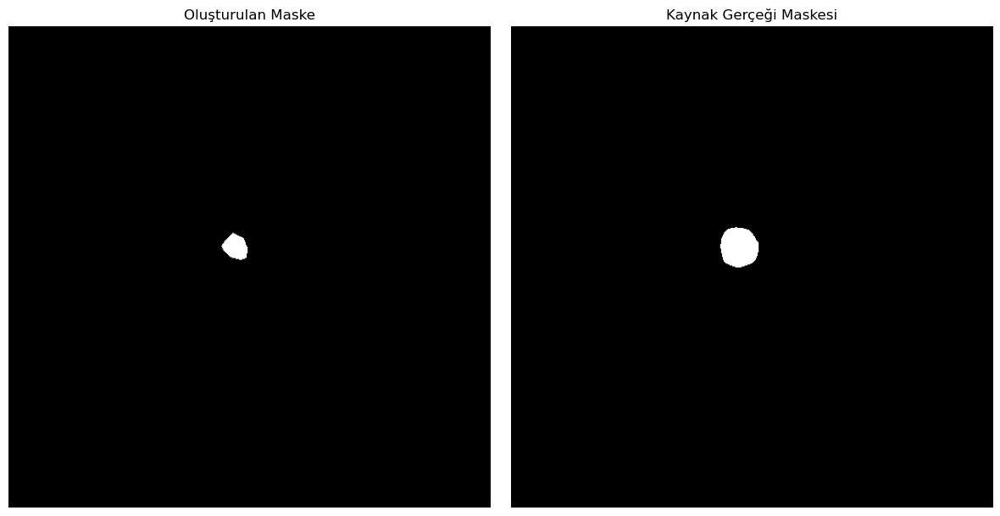

In [59]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Gerekirse bu yolu düzenleyin

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        # Anahtar Nokta nesnesini yeniden oluşturma
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Betimleyicileri NumPy dizisine dönüştürme
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni resmin ve kaynak gerçeği maskesinin yolu
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto2.png'  # Yeni resim için bu yolu düzenleyin
ground_truth_mask_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/foto2.png'  # Kaynak gerçeği maskesi

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı, lütfen dosya yolunu kontrol edin.")

# Kaynak gerçeği maskesinin yüklenmesi
ground_truth_mask = cv2.imread(ground_truth_mask_path, cv2.IMREAD_GRAYSCALE)
if ground_truth_mask is None:
    raise ValueError("Kaynak gerçeği maskesi bulunamadı, lütfen dosya yolunu kontrol edin.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()

# Yeni LBP resminden anahtar noktalar ve betimleyiciler çıkarma
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni resimdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# Betimleyicilerin mevcut olduğundan emin olma
if descriptors_saved is None or descriptors_new is None:
    raise ValueError("Betimleyiciler boş. Lütfen resimleri ve anahtar noktaları kontrol edin.")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN ile betimleyicileri eşleştirme
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulanması
good_matches = []
for m, n in matches:
    if m.distance < 0.65 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# İkili Maske (Binary Mask) oluşturma
if len(good_matches) > 0:
    # Yeni resimdeki eşleşen noktaları elde etme
    points_new = np.array([keypoints_new[m.trainIdx].pt for m in good_matches], dtype=np.float32)

    # Yeni resimle aynı boyutta boş bir maske oluşturma
    mask = np.zeros_like(new_image, dtype=np.uint8)

    # Yeterli nokta varsa Delaunay Üçgenleştirmesi uygulama
    if len(points_new) > 3:
        tri = Delaunay(points_new)
        for simplex in tri.simplices:
            pts = points_new[simplex].astype(int)
            cv2.fillConvexPoly(mask, pts, 255)

    # Üretilen maske ile kaynak gerçeği maskesi arasındaki IoU hesaplama
    intersection = np.logical_and(mask > 0, ground_truth_mask > 0).sum()
    union = np.logical_or(mask > 0, ground_truth_mask > 0).sum()
    iou = intersection / union if union > 0 else 0

    print(f"Intersection over Union (IoU): {iou:.4f}")

    # Üretilen maskeyi ve kaynak gerçeği maskesini görselleştirme
    plt.figure(figsize=(12, 6))  # Çerçeve boyutu
    titles = ['Oluşturulan Maske', 'Kaynak Gerçeği Maskesi']
    images = [mask, ground_truth_mask]

    # Resimleri gösterme
    for i in range(len(images)):
        plt.subplot(1, 2, i + 1)
        plt.imshow(images[i], cmap='gray')
        plt.title(titles[i])
        plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


IOU + Dilation 
 (Genişletme)

Kaydedilen toplam anahtar nokta sayısı: 217
Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 5836
İyi eşleşmelerin sayısı: 26
Intersection over Union (IoU): 0.8939


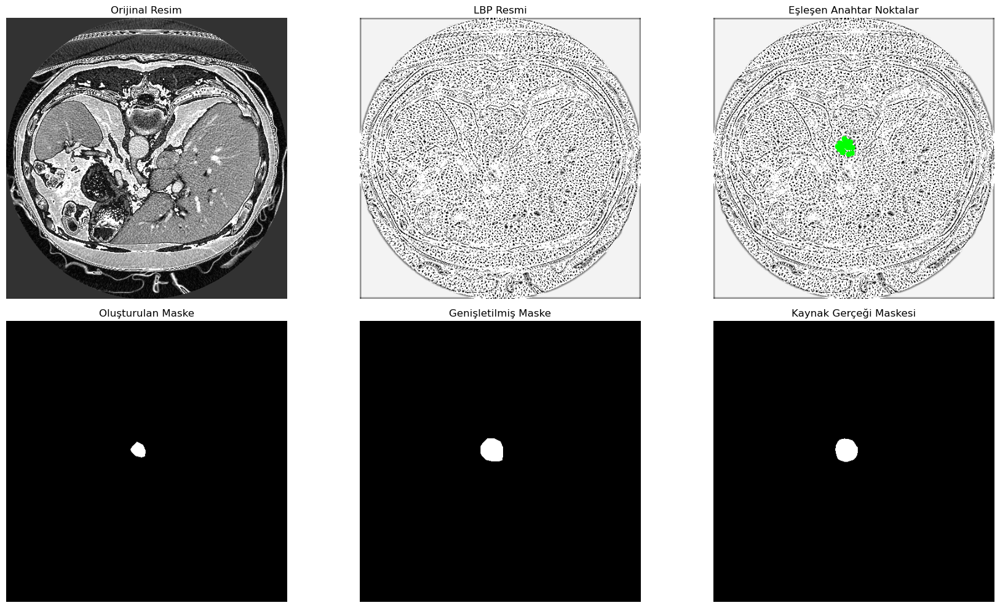

In [61]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Gerekirse bu yolu düzenleyin

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Betimleyicileri NumPy dizisine dönüştürme
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni resim ve kaynak gerçeği maskesi yolları
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto2.png'  # Yeni resim için bu yolu düzenleyin
ground_truth_mask_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/foto2.png'  # Kaynak gerçeği maskesi

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı, dosya yolunu kontrol edin.")

# Kaynak gerçeği maskesinin yüklenmesi
ground_truth_mask = cv2.imread(ground_truth_mask_path, cv2.IMREAD_GRAYSCALE)
if ground_truth_mask is None:
    raise ValueError("Kaynak gerçeği maskesi bulunamadı, dosya yolunu kontrol edin.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()

# Yeni LBP resminden anahtar noktalar ve betimleyiciler çıkarma
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni resimdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN ile betimleyicileri eşleştirme
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulanması
good_matches = []
for m, n in matches:
    if m.distance < 0.65 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# Maske oluşturma
if len(good_matches) > 0:
    points_new = np.array([keypoints_new[m.trainIdx].pt for m in good_matches], dtype=np.float32)
    matched_image = cv2.cvtColor(lbp_normalized, cv2.COLOR_GRAY2BGR)
    for pt in points_new:
        cv2.circle(matched_image, (int(pt[0]), int(pt[1])), 5, (0, 255, 0), -1)

    mask = np.zeros_like(new_image, dtype=np.uint8)
    if len(points_new) > 3:
        tri = Delaunay(points_new)
        for simplex in tri.simplices:
            pts = points_new[simplex].astype(int)
            cv2.fillConvexPoly(mask, pts, 255)

    kernel = np.ones((14, 14), np.uint8)
    dilated_mask = cv2.dilate(mask, kernel, iterations=1)

    intersection = np.logical_and(dilated_mask > 0, ground_truth_mask > 0).sum()
    union = np.logical_or(dilated_mask > 0, ground_truth_mask > 0).sum()
    iou = intersection / union if union > 0 else 0
    print(f"Intersection over Union (IoU): {iou:.4f}")

    # Tüm adımları görselleştirme
    plt.figure(figsize=(18, 10))
    images = [new_image, lbp_normalized, matched_image, mask, dilated_mask, ground_truth_mask]
    titles = [
        "Orijinal Resim",
        "LBP Resmi",
        "Eşleşen Anahtar Noktalar",
        "Oluşturulan Maske",
        "Genişletilmiş Maske",
        "Kaynak Gerçeği Maskesi"
    ]

    for i, (img, title) in enumerate(zip(images, titles)):
        plt.subplot(2, 3, i + 1)
        plt.imshow(img, cmap='gray' if len(img.shape) == 2 else None)
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


Proving being rotation invariant on one photo
Tek bir fotoğrafta dönüşe karşı değişmezliği kanıtlama

Kaydedilen toplam anahtar nokta sayısı: 217
Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 5836
İyi eşleşmelerin sayısı: 26
Intersection over Union (IoU): 0.8939


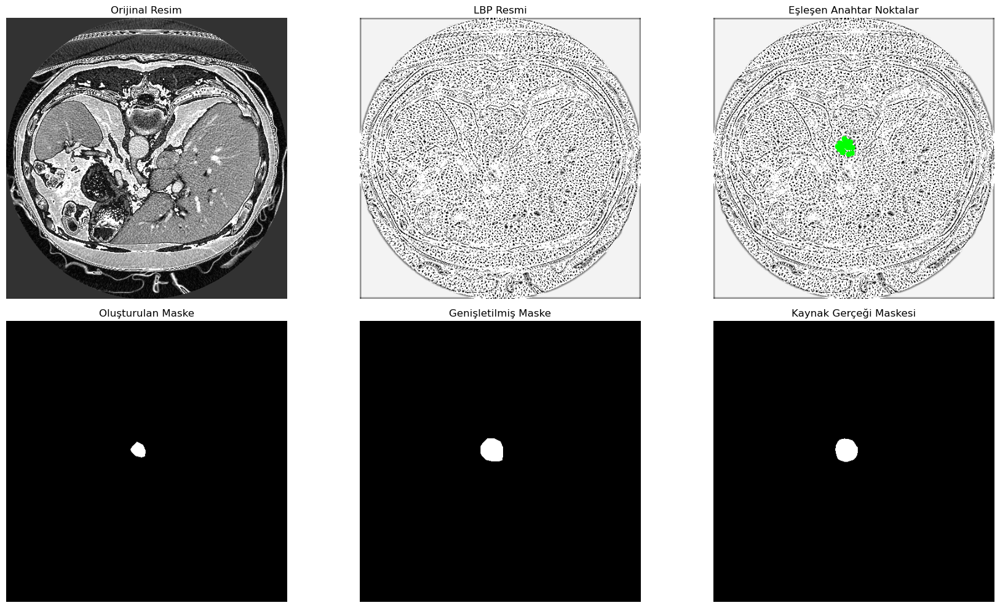

In [62]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Gerekirse bu yolu düzenleyin

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Betimleyicileri NumPy dizisine dönüştürme
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni resim ve kaynak gerçeği maskesi yolları
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto2.png'  # Yeni resim için bu yolu düzenleyin
ground_truth_mask_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/foto2.png'  # Kaynak gerçeği maskesi

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı, dosya yolunu kontrol edin.")

# Kaynak gerçeği maskesinin yüklenmesi
ground_truth_mask = cv2.imread(ground_truth_mask_path, cv2.IMREAD_GRAYSCALE)
if ground_truth_mask is None:
    raise ValueError("Kaynak gerçeği maskesi bulunamadı, dosya yolunu kontrol edin.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()

# Yeni LBP resminden anahtar noktalar ve betimleyiciler çıkarma
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni resimdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN ile betimleyicileri eşleştirme
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulanması
good_matches = []
for m, n in matches:
    if m.distance < 0.65 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# Maske oluşturma
if len(good_matches) > 0:
    points_new = np.array([keypoints_new[m.trainIdx].pt for m in good_matches], dtype=np.float32)
    matched_image = cv2.cvtColor(lbp_normalized, cv2.COLOR_GRAY2BGR)
    for pt in points_new:
        cv2.circle(matched_image, (int(pt[0]), int(pt[1])), 5, (0, 255, 0), -1)

    mask = np.zeros_like(new_image, dtype=np.uint8)
    if len(points_new) > 3:
        tri = Delaunay(points_new)
        for simplex in tri.simplices:
            pts = points_new[simplex].astype(int)
            cv2.fillConvexPoly(mask, pts, 255)

    kernel = np.ones((14, 14), np.uint8)
    dilated_mask = cv2.dilate(mask, kernel, iterations=1)

    intersection = np.logical_and(dilated_mask > 0, ground_truth_mask > 0).sum()
    union = np.logical_or(dilated_mask > 0, ground_truth_mask > 0).sum()
    iou = intersection / union if union > 0 else 0
    print(f"Intersection over Union (IoU): {iou:.4f}")

    # Tüm adımları görselleştirme
    plt.figure(figsize=(18, 10))
    images = [new_image, lbp_normalized, matched_image, mask, dilated_mask, ground_truth_mask]
    titles = [
        "Orijinal Resim",
        "LBP Resmi",
        "Eşleşen Anahtar Noktalar",
        "Oluşturulan Maske",
        "Genişletilmiş Maske",
        "Kaynak Gerçeği Maskesi"
    ]

    for i, (img, title) in enumerate(zip(images, titles)):
        plt.subplot(2, 3, i + 1)
        plt.imshow(img, cmap='gray' if len(img.shape) == 2 else None)
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


Tek bir fotoğraf üzerinde ölçek değişmezliğini kanıtlama

Kaydedilen toplam anahtar nokta sayısı: 217
Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 5735
İyi eşleşmelerin sayısı: 18
Intersection over Union (IoU): 0.8711


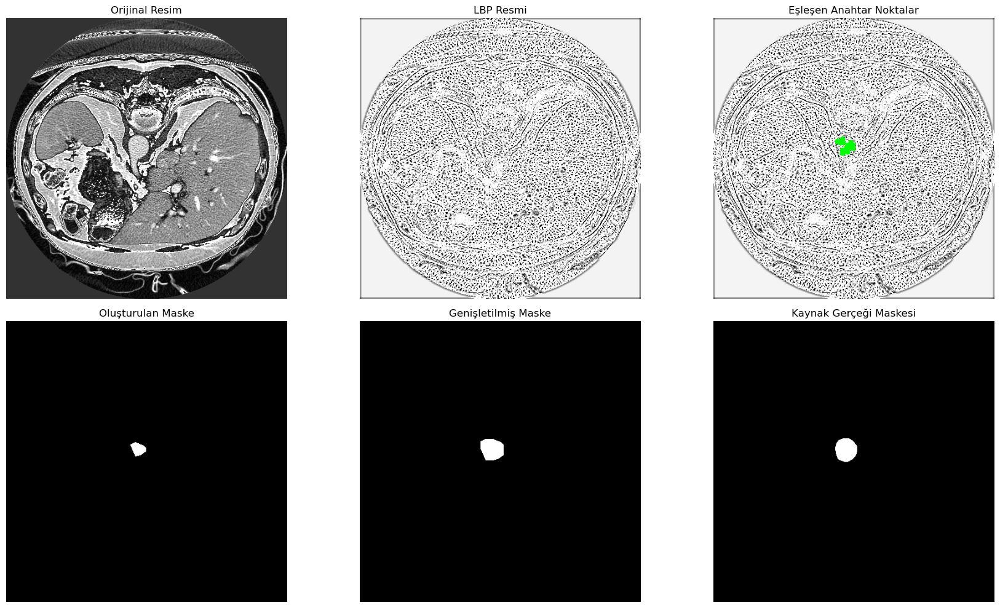

In [64]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Gerekirse bu yolu düzenleyin

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Betimleyicileri NumPy dizisine dönüştürme
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni resim ve kaynak gerçeği maskesi yolları
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto3.png'  # Yeni resim için bu yolu düzenleyin
ground_truth_mask_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/foto3.png'

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı, dosya yolunu kontrol edin.")

# Kaynak gerçeği maskesinin yüklenmesi
ground_truth_mask = cv2.imread(ground_truth_mask_path, cv2.IMREAD_GRAYSCALE)
if ground_truth_mask is None:
    raise ValueError("Kaynak gerçeği maskesi bulunamadı, dosya yolunu kontrol edin.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()

# Yeni LBP resminden anahtar noktalar ve betimleyiciler çıkarma
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni resimdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN ile betimleyicileri eşleştirme
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulanması
good_matches = []
for m, n in matches:
    if m.distance < 0.65 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# Maske oluşturma
if len(good_matches) > 0:
    points_new = np.array([keypoints_new[m.trainIdx].pt for m in good_matches], dtype=np.float32)
    matched_image = cv2.cvtColor(lbp_normalized, cv2.COLOR_GRAY2BGR)
    for pt in points_new:
        cv2.circle(matched_image, (int(pt[0]), int(pt[1])), 5, (0, 255, 0), -1)

    mask = np.zeros_like(new_image, dtype=np.uint8)
    if len(points_new) > 3:
        tri = Delaunay(points_new)
        for simplex in tri.simplices:
            pts = points_new[simplex].astype(int)
            cv2.fillConvexPoly(mask, pts, 255)

    kernel = np.ones((14, 14), np.uint8)
    dilated_mask = cv2.dilate(mask, kernel, iterations=1)

    intersection = np.logical_and(dilated_mask > 0, ground_truth_mask > 0).sum()
    union = np.logical_or(dilated_mask > 0, ground_truth_mask > 0).sum()
    iou = intersection / union if union > 0 else 0
    print(f"Intersection over Union (IoU): {iou:.4f}")

    # Tüm adımları görselleştirme
    plt.figure(figsize=(18, 10))
    images = [new_image, lbp_normalized, matched_image, mask, dilated_mask, ground_truth_mask]
    titles = [
        "Orijinal Resim",
        "LBP Resmi",
        "Eşleşen Anahtar Noktalar",
        "Oluşturulan Maske",
        "Genişletilmiş Maske",
        "Kaynak Gerçeği Maskesi"
    ]

    for i, (img, title) in enumerate(zip(images, titles)):
        plt.subplot(2, 3, i + 1)
        plt.imshow(img, cmap='gray' if len(img.shape) == 2 else None)
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


ikisini birlikte kanıtlamak 

Kaydedilen toplam anahtar nokta sayısı: 217
Yeni resimdeki anahtar nokta sayısı (LBP sonrası): 5039
İyi eşleşmelerin sayısı: 8
Intersection over Union (IoU): 0.7507


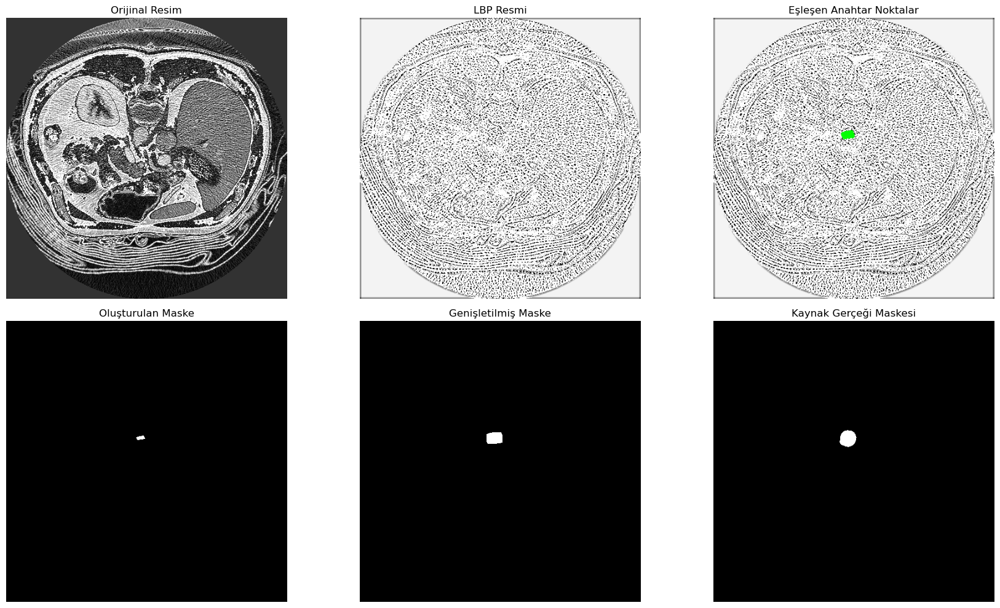

In [65]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'  # Gerekirse bu yolu düzenleyin

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Kaydedilen tüm resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Betimleyicileri NumPy dizisine dönüştürme
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# Yeni resim ve kaynak gerçeği maskesi yolları
new_image_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/foto/foto4.png'  # Yeni resim için bu yolu düzenleyin
ground_truth_mask_path = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/fotolab/foto4.png'  

# Yeni resmin yüklenmesi
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
if new_image is None:
    raise ValueError("Yeni resim bulunamadı, dosya yolunu kontrol edin.")

# Kaynak gerçeği maskesinin yüklenmesi
ground_truth_mask = cv2.imread(ground_truth_mask_path, cv2.IMREAD_GRAYSCALE)
if ground_truth_mask is None:
    raise ValueError("Kaynak gerçeği maskesi bulunamadı, dosya yolunu kontrol edin.")

# Yeni resme LBP uygulanması
lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

# LBP sonucunun normalizasyonu
lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

# SIFT nesnesi oluşturma
sift = cv2.SIFT_create()

# Yeni LBP resminden anahtar noktalar ve betimleyiciler çıkarma
keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

print(f"Yeni resimdeki anahtar nokta sayısı (LBP sonrası): {len(keypoints_new)}")

# FLANN matcher ayarları
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
search_params = dict(checks=200)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# KNN ile betimleyicileri eşleştirme
matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

# Lowe oran testi uygulanması
good_matches = []
for m, n in matches:
    if m.distance < 0.65 * n.distance:
        good_matches.append(m)

print(f"İyi eşleşmelerin sayısı: {len(good_matches)}")

# Maske oluşturma
if len(good_matches) > 0:
    points_new = np.array([keypoints_new[m.trainIdx].pt for m in good_matches], dtype=np.float32)
    matched_image = cv2.cvtColor(lbp_normalized, cv2.COLOR_GRAY2BGR)
    for pt in points_new:
        cv2.circle(matched_image, (int(pt[0]), int(pt[1])), 5, (0, 255, 0), -1)

    mask = np.zeros_like(new_image, dtype=np.uint8)
    if len(points_new) > 3:
        tri = Delaunay(points_new)
        for simplex in tri.simplices:
            pts = points_new[simplex].astype(int)
            cv2.fillConvexPoly(mask, pts, 255)

    kernel = np.ones((14, 14), np.uint8)
    dilated_mask = cv2.dilate(mask, kernel, iterations=1)

    intersection = np.logical_and(dilated_mask > 0, ground_truth_mask > 0).sum()
    union = np.logical_or(dilated_mask > 0, ground_truth_mask > 0).sum()
    iou = intersection / union if union > 0 else 0
    print(f"Intersection over Union (IoU): {iou:.4f}")

    # Tüm adımları görselleştirme
    plt.figure(figsize=(18, 10))
    images = [new_image, lbp_normalized, matched_image, mask, dilated_mask, ground_truth_mask]
    titles = [
        "Orijinal Resim",
        "LBP Resmi",
        "Eşleşen Anahtar Noktalar",
        "Oluşturulan Maske",
        "Genişletilmiş Maske",
        "Kaynak Gerçeği Maskesi"
    ]

    for i, (img, title) in enumerate(zip(images, titles)):
        plt.subplot(2, 3, i + 1)
        plt.imshow(img, cmap='gray' if len(img.shape) == 2 else None)
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Hiçbir iyi eşleşme bulunamadı.")


Kaydedilen toplam anahtar nokta sayısı: 217
C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_62.png: İyi eşleşmelerin sayısı: 15
C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_62.png: IoU = 0.7736


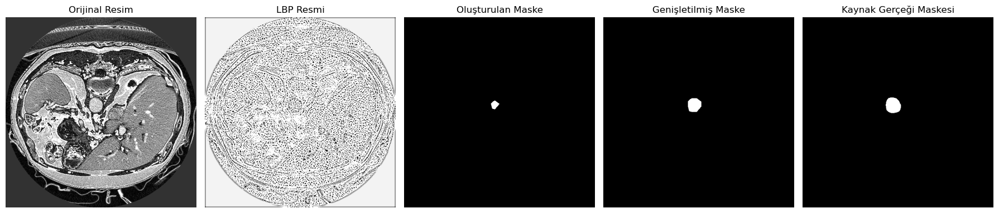

C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_63.png: İyi eşleşmelerin sayısı: 26
C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_63.png: IoU = 0.8939


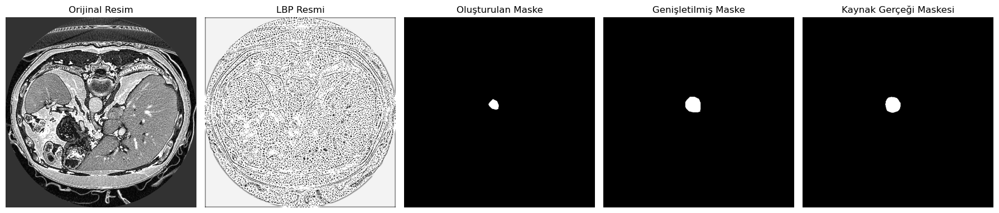

C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_64.png: İyi eşleşmelerin sayısı: 18
C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_64.png: IoU = 0.8711


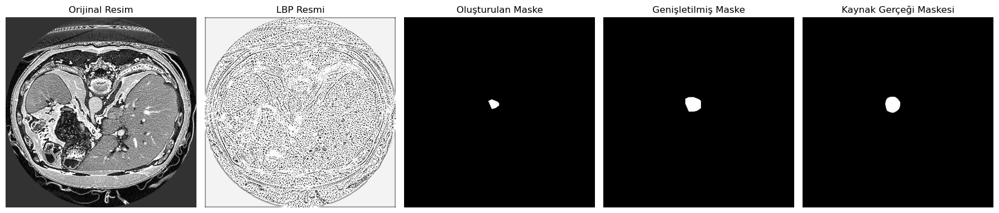

C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0005_slice_43.png: İyi eşleşmelerin sayısı: 7
C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0005_slice_43.png: IoU = 0.6511


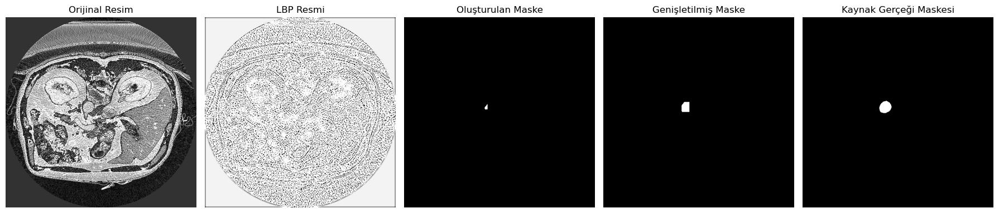

C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0003_slice_53.png: İyi eşleşmelerin sayısı: 6
C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0003_slice_53.png: IoU = 0.5329


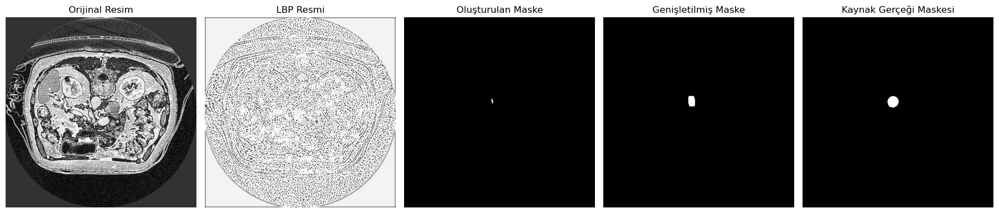

C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0004_slice_44.png: İyi eşleşmelerin sayısı: 3
C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0004_slice_44.png: IoU = 0.0000


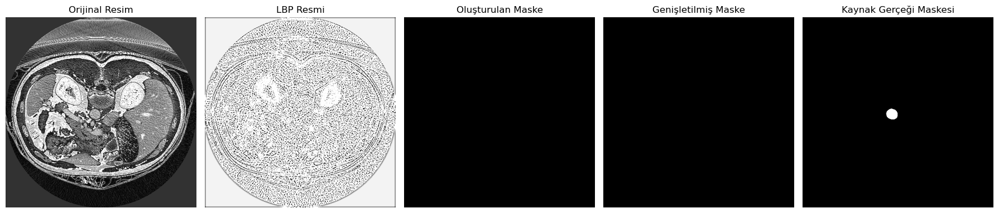

C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0002_slice_62.png: İyi eşleşmelerin sayısı: 8
C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0002_slice_62.png: IoU = 0.7507


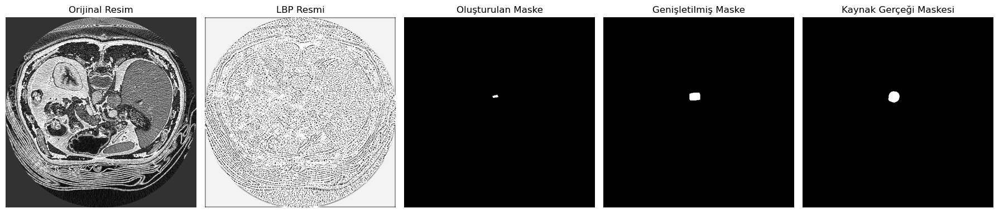

C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0003_slice_55.png: İyi eşleşmelerin sayısı: 3
C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0003_slice_55.png: IoU = 0.0000


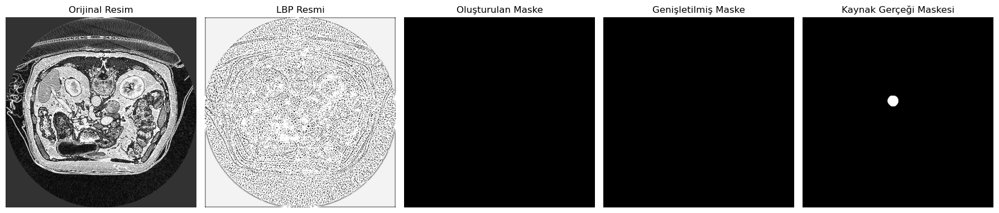

Ortalama IoU: 0.5592


In [66]:
import cv2
import pickle
import numpy as np
from skimage.feature import local_binary_pattern
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt

# LBP Ayarları
radius = 3
n_points = 8 * radius
METHOD = 'uniform'

# Dosya yolları (10 resim ve maske)
image_paths = [
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_62.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_63.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0001_slice_64.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0005_slice_43.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0003_slice_53.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0004_slice_44.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0002_slice_62.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/output/output_FLARE22_Tr_0003_slice_55.png'


    
]
mask_paths = [
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/labels/FLARE22_Tr_0001_slice_62.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/labels/FLARE22_Tr_0001_slice_63.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/labels/FLARE22_Tr_0001_slice_64.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/labels/FLARE22_Tr_0005_slice_43.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/labels/FLARE22_Tr_0003_slice_53.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/labels/FLARE22_Tr_0004_slice_44.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/labels/FLARE22_Tr_0002_slice_62.png',
    'C:/Users/logotech/Downloads/5-aorta/5-aorta/labels/FLARE22_Tr_0003_slice_55.png'

    
    
]

# Kaydedilen anahtar noktalar dosyasının yolu
all_keypoints_file = 'C:/Users/logotech/Downloads/5-aorta/5-aorta/all_keypoints.pkl'

# Kaydedilen verilerin okunması
with open(all_keypoints_file, 'rb') as f:
    all_keypoints_dict = pickle.load(f)

# Tüm kaydedilen resimlerden anahtar noktaları ve betimleyicileri birleştirme
keypoints_saved = []
descriptors_saved = []

for file_name, keypoints_list in all_keypoints_dict.items():
    for kp_dict in keypoints_list:
        kp = cv2.KeyPoint(
            kp_dict['pt'][0],
            kp_dict['pt'][1],
            kp_dict['size'],
            kp_dict['angle'],
            kp_dict['response'],
            int(kp_dict['octave']),
            kp_dict['class_id']
        )
        keypoints_saved.append(kp)
        descriptors_saved.append(kp_dict['descriptor'])

# Betimleyicileri NumPy dizisine dönüştürme
descriptors_saved = np.array(descriptors_saved, dtype=np.float32)

print(f"Kaydedilen toplam anahtar nokta sayısı: {len(keypoints_saved)}")

# IoU değerlerini saklamak için bir liste
iou_scores = []

# 10 resim ve maske üzerinde döngü
for new_image_path, ground_truth_mask_path in zip(image_paths, mask_paths):
    # Yeni resim ve kaynak gerçeği maskesi yükleme
    new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)
    ground_truth_mask = cv2.imread(ground_truth_mask_path, cv2.IMREAD_GRAYSCALE)

    if new_image is None or ground_truth_mask is None:
        print(f"Görüntü veya maske yüklenemedi: {new_image_path}, {ground_truth_mask_path}")
        continue

    # Yeni resme LBP uygulanması
    lbp_new = local_binary_pattern(new_image, n_points, radius, METHOD)

    # LBP sonucunun normalizasyonu
    lbp_normalized = cv2.normalize(lbp_new, None, 0, 255, cv2.NORM_MINMAX).astype('uint8')

    # SIFT nesnesi oluşturma
    sift = cv2.SIFT_create()

    # Yeni LBP resminden anahtar noktalar ve betimleyiciler çıkarma
    keypoints_new, descriptors_new = sift.detectAndCompute(lbp_normalized, None)

    if descriptors_new is None:
        print(f"Betimleyiciler bulunamadı: {new_image_path}")
        continue

    # FLANN matcher ayarları
    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=50)
    search_params = dict(checks=200)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # KNN ile betimleyicileri eşleştirme
    matches = flann.knnMatch(descriptors_saved, descriptors_new, k=2)

    # Lowe oran testi
    good_matches = []
    for m, n in matches:
        if m.distance < 0.65 * n.distance:
            good_matches.append(m)

    print(f"{new_image_path}: İyi eşleşmelerin sayısı: {len(good_matches)}")

    # Maske oluşturma
    if len(good_matches) > 0:
        points_new = np.array([keypoints_new[m.trainIdx].pt for m in good_matches], dtype=np.float32)
        mask = np.zeros_like(new_image, dtype=np.uint8)

        if len(points_new) > 3:
            tri = Delaunay(points_new)
            for simplex in tri.simplices:
                pts = points_new[simplex].astype(int)
                cv2.fillConvexPoly(mask, pts, 255)

        kernel = np.ones((14, 14), np.uint8)
        dilated_mask = cv2.dilate(mask, kernel, iterations=1)

        # IoU hesaplama
        intersection = np.logical_and(dilated_mask > 0, ground_truth_mask > 0).sum()
        union = np.logical_or(dilated_mask > 0, ground_truth_mask > 0).sum()
        iou = intersection / union if union > 0 else 0
        iou_scores.append(iou)

        print(f"{new_image_path}: IoU = {iou:.4f}")

        # Görselleştirme
        plt.figure(figsize=(18, 6))
        images = [new_image, lbp_normalized, mask, dilated_mask, ground_truth_mask]
        titles = ["Orijinal Resim", "LBP Resmi", "Oluşturulan Maske", "Genişletilmiş Maske", "Kaynak Gerçeği Maskesi"]

        for i, (img, title) in enumerate(zip(images, titles)):
            plt.subplot(1, 5, i + 1)
            plt.imshow(img, cmap='gray')
            plt.title(title)
            plt.axis('off')

        plt.tight_layout()
        plt.show()

# Ortalama IoU hesaplama
average_iou = np.mean(iou_scores)
print(f"Ortalama IoU: {average_iou:.4f}")
